# Concevez une application au service de la santé publique

## Notebook Exploration

### 1. Imports

In [591]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import re
from sklearn.impute import KNNImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import SimpleImputer

In [592]:
data = pd.read_csv('fr.openfoodfacts.org.products.csv', sep = '\t')
#pd.set_option('display.max_columns', None)## visualiser toutes les colonnes
#pd.set_option('display.max_row', None)## visualiser toutes les lignes


C:\Users\naoue\AppData\Local\Temp\ipykernel_16248\979112462.py:1: DtypeWarning: Columns (0,3,5,19,20,24,25,26,27,28,35,36,37,38,39,48) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('fr.openfoodfacts.org.products.csv', sep = '\t')


In [593]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 320772 entries, 0 to 320771
Columns: 162 entries, code to water-hardness_100g
dtypes: float64(106), object(56)
memory usage: 396.5+ MB


### 2. Comprehension des donnees

In [594]:
print(data.dtypes)

code                                           object
url                                            object
creator                                        object
created_t                                      object
created_datetime                               object
last_modified_t                                object
last_modified_datetime                         object
product_name                                   object
generic_name                                   object
quantity                                       object
packaging                                      object
packaging_tags                                 object
brands                                         object
brands_tags                                    object
categories                                     object
categories_tags                                object
categories_fr                                  object
origins                                        object
origins_tags                

In [595]:
data.shape

(320772, 162)

In [596]:
data.describe()

,no_nutriments,additives_n,ingredients_from_palm_oil_n,ingredients_from_palm_oil,ingredients_that_may_be_from_palm_oil_n,ingredients_that_may_be_from_palm_oil,nutrition_grade_uk,energy_100g,energy-from-fat_100g,fat_100g,...,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
count,0.0,248939.000000,248939.000000,0.0,248939.000000,0.0,0.0,2.611130e+05,857.000000,243891.000000,...,49.000000,3036.000000,165.000000,948.000000,0.0,268.000000,221210.000000,221210.000000,0.0,0.0
mean,NaN,1.936024,0.019659,NaN,0.055246,NaN,NaN,1.141915e+03,585.501214,12.730379,...,6.425698,31.458587,15.412121,49.547785,NaN,341.700764,9.165535,9.058049,NaN,NaN
std,NaN,2.502019,0.140524,NaN,0.269207,NaN,NaN,6.447154e+03,712.809943,17.578747,...,2.047841,31.967918,3.753028,18.757932,NaN,425.211439,9.055903,9.183589,NaN,NaN
min,NaN,0.000000,0.000000,NaN,0.000000,NaN,NaN,0.000000e+00,0.000000,0.000000,...,0.000000,0.000000,8.000000,6.000000,NaN,0.000000,-15.000000,-15.000000,NaN,NaN
25%,NaN,0.000000,0.000000,NaN,0.000000,NaN,NaN,3.770000e+02,49.400000,0.000000,...,6.300000,0.000000,12.000000,32.000000,NaN,98.750000,1.000000,1.000000,NaN,NaN
50%,NaN,1.000000,0.000000,NaN,0.000000,NaN,NaN,1.100000e+03,300.000000,5.000000,...,7.200000,23.000000,15.000000,50.000000,NaN,195.750000,10.000000,9.000000,NaN,NaN
75%,NaN,3.000000,0.000000,NaN,0.000000,NaN,NaN,1.674000e+03,898.000000,20.000000,...,7.400000,51.000000,15.000000,64.250000,NaN,383.200000,16.000000,16.000000,NaN,NaN
max,NaN,31.000000,2.000000,NaN,6.000000,NaN,NaN,3.251373e+06,3830.000000,714.290000,...,8.400000,100.000000,25.000000,100.000000,NaN,2842.000000,40.000000,40.000000,NaN,NaN


### 3.Les variables

In [277]:
column_list = data.columns.tolist()## print la liste des colonnes
column_list


['code',
 'url',
 'creator',
 'created_t',
 'created_datetime',
 'last_modified_t',
 'last_modified_datetime',
 'product_name',
 'generic_name',
 'quantity',
 'packaging',
 'packaging_tags',
 'brands',
 'brands_tags',
 'categories',
 'categories_tags',
 'categories_fr',
 'origins',
 'origins_tags',
 'manufacturing_places',
 'manufacturing_places_tags',
 'labels',
 'labels_tags',
 'labels_fr',
 'emb_codes',
 'emb_codes_tags',
 'first_packaging_code_geo',
 'cities',
 'cities_tags',
 'purchase_places',
 'stores',
 'countries',
 'countries_tags',
 'countries_fr',
 'ingredients_text',
 'allergens',
 'allergens_fr',
 'traces',
 'traces_tags',
 'traces_fr',
 'serving_size',
 'no_nutriments',
 'additives_n',
 'additives',
 'additives_tags',
 'additives_fr',
 'ingredients_from_palm_oil_n',
 'ingredients_from_palm_oil',
 'ingredients_from_palm_oil_tags',
 'ingredients_that_may_be_from_palm_oil_n',
 'ingredients_that_may_be_from_palm_oil',
 'ingredients_that_may_be_from_palm_oil_tags',
 'nutritio

### pourcentage de completude pour chaque variable

In [278]:
null_percentage = data.isnull().mean()

In [279]:
data.loc[:,data.isnull().any()].isnull().mean()

code                                          0.000072
url                                           0.000072
creator                                       0.000006
created_t                                     0.000009
created_datetime                              0.000028
product_name                                  0.055373
generic_name                                  0.835413
quantity                                      0.673229
packaging                                     0.753844
packaging_tags                                0.753841
brands                                        0.088574
brands_tags                                   0.088599
categories                                    0.736854
categories_tags                               0.736919
categories_fr                                 0.736850
origins                                       0.930823
origins_tags                                  0.930938
manufacturing_places                          0.886209
manufactur

### afficher dans un dataset chaque colonne avec le pourcentage de valeurs présente plus le nombre de valeurs manquantes


In [597]:
def rate_completion(data):
    """
    Compute sorted completion rate and number of missing values for each variable of the argument in a descending order
 
    """
    var_dict = {}
    
    for col in data.columns:
        var_dict[col] = []
        var_dict[col].append(round((data[col].notna().sum()/data.shape[0])*100,2))
        var_dict[col].append(data[col].isna().sum())
        
    return pd.DataFrame.from_dict(data=var_dict, orient="index", columns = ["completion_rate", "number_of_missing_data"]).sort_values(by="completion_rate", ascending=False)

In [477]:
pd.set_option('display.max_rows',None)

rate_completion_data = rate_completion(data)
rate_completion_data

,completion_rate,number_of_missing_data
creator,100.00,2
created_t,100.00,3
created_datetime,100.00,9
last_modified_t,100.00,0
last_modified_datetime,100.00,0
code,99.99,23
states_fr,99.99,46
states_tags,99.99,46
states,99.99,46
url,99.99,23


In [598]:
data["water-hardness_100g"].isnull().sum()

320772

#### colonne product name

In [283]:
data['product_name']

0                                        Farine de blé noir
1                            Banana Chips Sweetened (Whole)
2                                                   Peanuts
3                                    Organic Salted Nut Mix
4                                           Organic Polenta
5                         Breadshop Honey Gone Nuts Granola
6                             Organic Long Grain White Rice
7                                            Organic Muesli
8                              Organic Dark Chocolate Minis
9                                     Organic Sunflower Oil
10                                     Organic Adzuki Beans
11                                      Organic Penne Pasta
12                                            Zen Party Mix
13                                Organic Golden Flax Seeds
14                                      Organic Spicy Punks
15                                     Cinnamon Nut Granola
16                                      

#### colonne brand

In [284]:
data['brands'].value_counts()

Carrefour                                                                                                                                                                                                                               2978
Auchan                                                                                                                                                                                                                                  2340
U                                                                                                                                                                                                                                       2050
Meijer                                                                                                                                                                                                                                  1995
Leader Price                                        

## 4.Premier filtre sur les données

### Supprimer les colonnes avec que des valeurs NAN

In [599]:
data = data.dropna(axis=0, how="all")


In [600]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 320772 entries, 0 to 320771
Columns: 162 entries, code to water-hardness_100g
dtypes: float64(106), object(56)
memory usage: 396.5+ MB


#### Garder les produits vendu en france seulement

In [287]:
data['countries'].value_counts()

US                                                                                                                                                                                                                                                                                                                                          169928
France                                                                                                                                                                                                                                                                                                                                       77292
en:FR                                                                                                                                                                                                                                                                                                                             

In [601]:
data['countries'] = data["countries"].astype(str)# transformer la colonne countries en type str.

In [602]:
cond = data['countries'].apply( lambda x: any([("FR" in elem) or ("France" in elem) or 
                                        (elem.startswith('FR')) or (elem.endswith('FR'))
                                        or (elem.startswith('France')) or (elem.endswith('France'))
                                        for elem in x.split(',')]))

In [603]:
data = data[cond]

In [604]:
data.dtypes

code                                           object
url                                            object
creator                                        object
created_t                                      object
created_datetime                               object
last_modified_t                                object
last_modified_datetime                         object
product_name                                   object
generic_name                                   object
quantity                                       object
packaging                                      object
packaging_tags                                 object
brands                                         object
brands_tags                                    object
categories                                     object
categories_tags                                object
categories_fr                                  object
origins                                        object
origins_tags                

In [605]:
data.shape

(97548, 162)

### vérifier les résultats

In [293]:
data['countries'].value_counts()

France                                                                                                                                                                                                                 77292
en:FR                                                                                                                                                                                                                  16979
France, Suisse                                                                                                                                                                                                           506
Belgique,France                                                                                                                                                                                                          219
France,Suisse                                                                                                       

In [486]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 97548 entries, 0 to 320770
Columns: 162 entries, code to water-hardness_100g
dtypes: float64(106), object(56)
memory usage: 121.3+ MB


### 5. Analyse univariee

### creer un dataset avec une liste de  colonne les plus pertinente et ainsi effectuer une analyse sur ces colonnes


In [606]:
data_display = data[["additives_n","energy_100g","proteins_100g","sugars_100g","alcohol_100g",
                          "fat_100g" ,"saturated-fat_100g", "fat_100g","carbohydrates_100g","salt_100g","fiber_100g",
                     "iron_100g","calcium_100g",
                            "nutrition-score-fr_100g","nutrition_grade_fr",'brands',"ingredients_text"]]

In [607]:
data_display.head()

,additives_n,energy_100g,proteins_100g,sugars_100g,alcohol_100g,fat_100g,saturated-fat_100g,fat_100g,carbohydrates_100g,salt_100g,fiber_100g,iron_100g,calcium_100g,nutrition-score-fr_100g,nutrition_grade_fr,brands,ingredients_text
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Ferme t'y R'nao,NaN
46,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
48,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
106,1.0,1883.0,2.5,57.5,NaN,20.0,12.5,20.0,70.0,0.09652,2.5,0.0009,0.1,22.0,e,Sunridge,"Milk chocolate coating (evaporated cane juice,..."
136,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [297]:
data_display.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 97548 entries, 0 to 320770
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   additives_n              52880 non-null  float64
 1   energy_100g              64019 non-null  float64
 2   proteins_100g            63752 non-null  float64
 3   sugars_100g              61986 non-null  float64
 4   alcohol_100g             2368 non-null   float64
 5   fat_100g                 47072 non-null  float64
 6   saturated-fat_100g       61850 non-null  float64
 7   fat_100g                 47072 non-null  float64
 8   carbohydrates_100g       46645 non-null  float64
 9   salt_100g                62049 non-null  float64
 10  fiber_100g               45363 non-null  float64
 11  iron_100g                1141 non-null   float64
 12  calcium_100g             2176 non-null   float64
 13  nutrition-score-fr_100g  60900 non-null  float64
 14  nutrition_grade_fr   

### visualisation de la liste des colonnes séléctionnees

array([<AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
       <AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
       <AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
       <AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
       <AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
       <AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>,
       <AxesSubplot:ylabel='Density'>, <AxesSubplot:ylabel='Density'>],
      dtype=object)

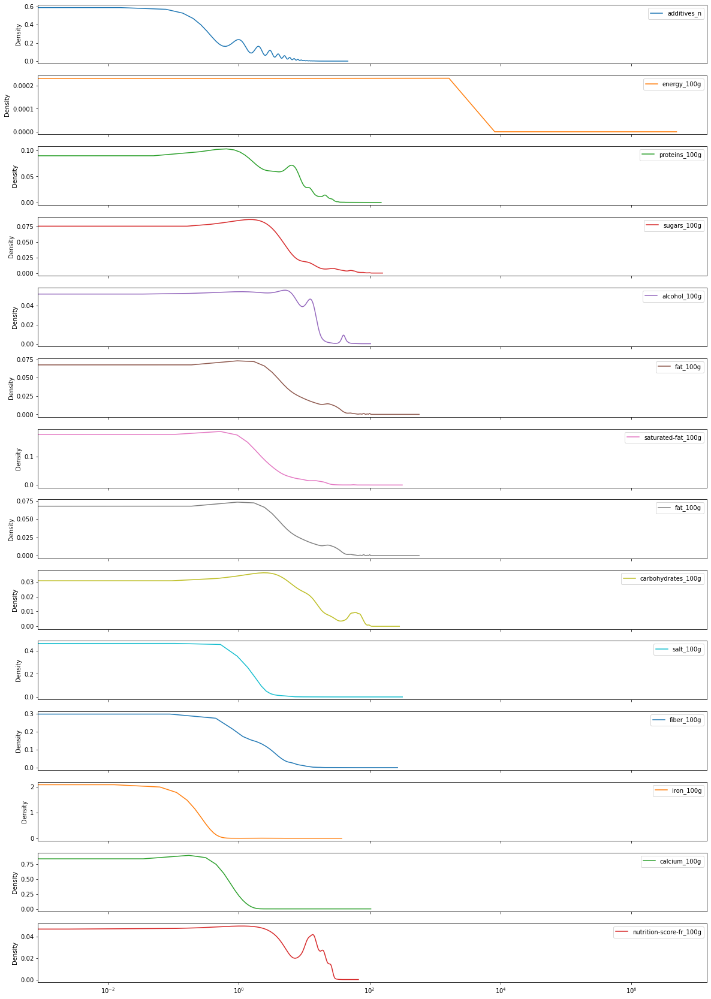

In [298]:

data_display.plot.kde(subplots = True,figsize = (20,30),logx=True)

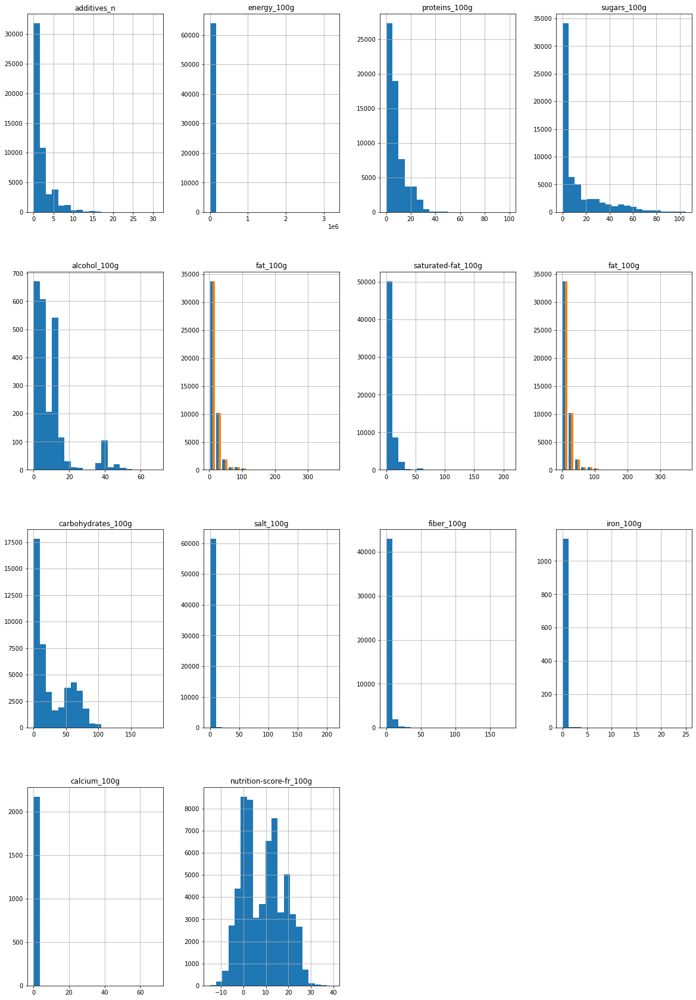

In [299]:
data_display.hist( bins = 20,figsize = (20,30))
plt.show()

Text(0.5, 1.0, 'representation de la colonne nutrition grade')

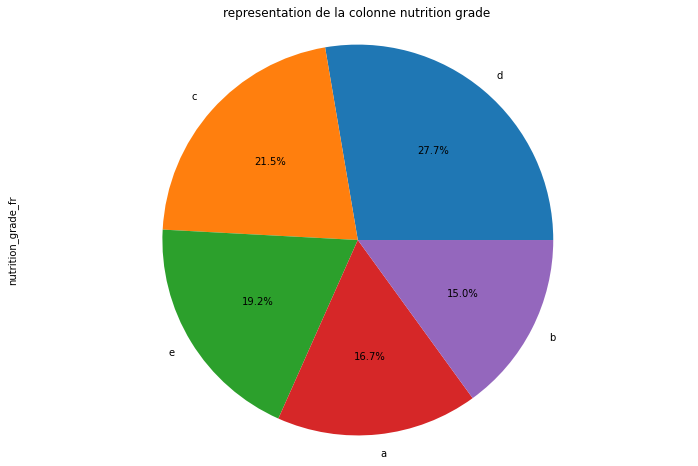

In [300]:
plt.figure(figsize= (12,8))
data_display["nutrition_grade_fr"].value_counts().plot(kind= 'pie',autopct='%1.1f%%')
plt.axis('equal')
plt.title('representation de la colonne nutrition grade')


Text(0.5, 1.0, 'representation de la colonne nutrition grade /100g')

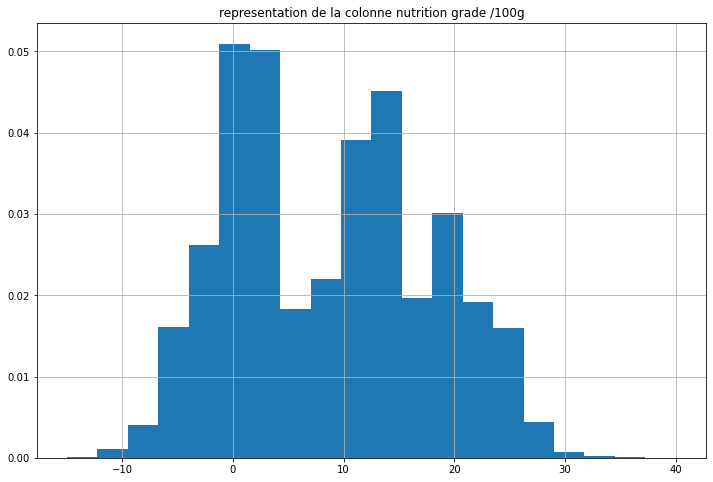

In [301]:
plt.figure(figsize= (12,8))
data_display["nutrition-score-fr_100g"].hist(density = True,bins = 20)
plt.title('representation de la colonne nutrition grade /100g')

<AxesSubplot:ylabel='Frequency'>

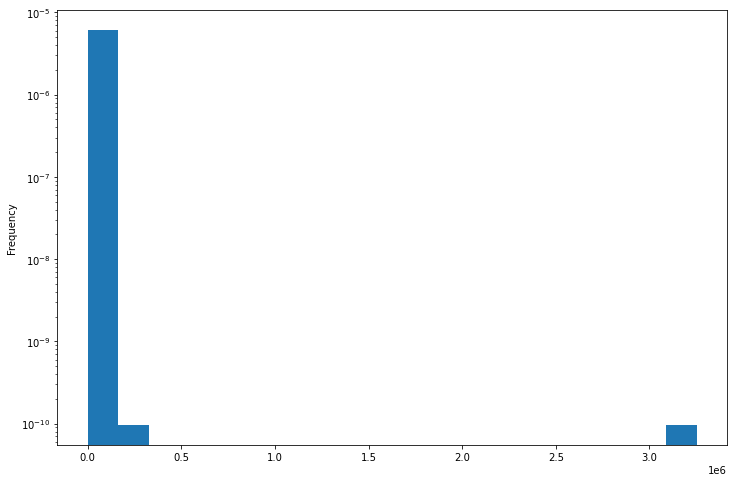

In [302]:
plt.figure(figsize = (12,8))
data_display["energy_100g"].plot.hist(density = True,bins =20,logy = True)


### 6. Les valeurs aberrantes

#### regarder la distribution de la colonne energy pour mieux comprendre avant le traitement des valeurs abérantes

In [487]:
data["energy_100g"].describe()

count    6.401900e+04
mean     1.170382e+03
std      1.289310e+04
min      0.000000e+00
25%      4.270000e+02
50%      1.033000e+03
75%      1.647500e+03
max      3.251373e+06
Name: energy_100g, dtype: float64

In [488]:
data["energy_100g"].min()

0.0


#### rechercher les colonnes avec le nom energy 

In [608]:
find_energy = data[data.columns[data.columns.str.startswith("energy")]]

In [609]:
find_energy.columns

Index(['energy_100g', 'energy-from-fat_100g'], dtype='object')

In [610]:
# renomer cette colonne a fin de ne pas effectuer les meme transformation que les autres colonnes avec la meme nomenclature 
data = data.rename(columns = {'energy_100g' :"energy_kj"})

In [611]:
data.head()

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
0,3087,http://world-fr.openfoodfacts.org/produit/0000...,openfoodfacts-contributors,1474103866,2016-09-17T09:17:46Z,1474103893,2016-09-17T09:18:13Z,Farine de blé noir,NaN,1kg,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
46,24600,http://world-fr.openfoodfacts.org/produit/0000...,date-limite-app,1434530704,2015-06-17T08:45:04Z,1434535914,2015-06-17T10:11:54Z,Filet de bœuf,NaN,2.46 kg,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
48,27205,http://world-fr.openfoodfacts.org/produit/0000...,tacinte,1458238630,2016-03-17T18:17:10Z,1458238638,2016-03-17T18:17:18Z,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
106,36252,http://world-fr.openfoodfacts.org/produit/0000...,tacinte,1422221701,2015-01-25T21:35:01Z,1489055667,2017-03-09T10:34:27Z,Lion Peanut x2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,22.0,22.0,NaN,NaN
136,39259,http://world-fr.openfoodfacts.org/produit/0000...,tacinte,1422221773,2015-01-25T21:36:13Z,1473538082,2016-09-10T20:08:02Z,Twix x2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Supprimer les valeurs aberrantes

###  colonne energy_kj

In [612]:
data["energy_kj"].max()

3251373.0

In [613]:
data["energy_kj"].min()

0.0

In [614]:
cond_energy_kcal = data["energy_kj"]<= 3800

In [615]:
data= data[cond_energy_kcal]

In [616]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 63928 entries, 106 to 320763
Columns: 162 entries, code to water-hardness_100g
dtypes: float64(106), object(56)
memory usage: 79.5+ MB


### observer la colonne aprés la suppression des valeurs abérantes

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='energy_kj'>

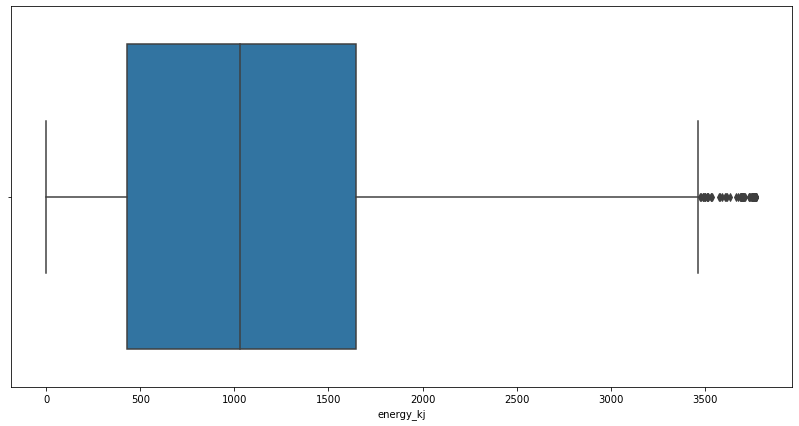

In [314]:
plt.figure(figsize=(14,7))
sns.boxplot(data["energy_kj"])

Text(0.5, 1.0, 'representation de la colonne energy  kj aprés la supression des valeurs abérantes')

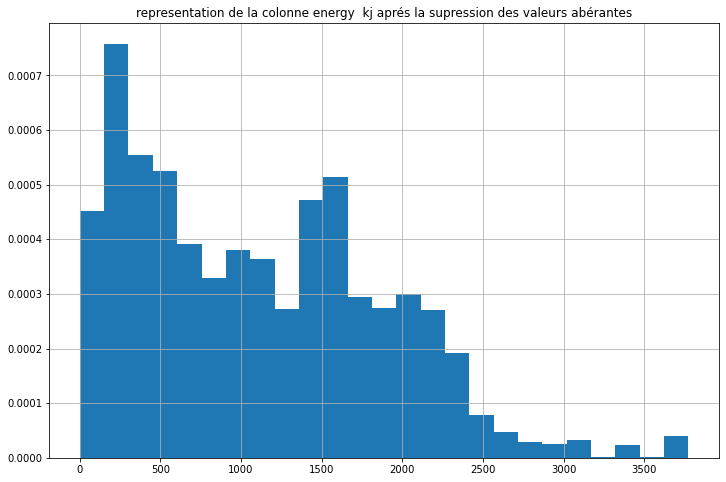

In [315]:
plt.figure(figsize = (12,8))
data["energy_kj"].hist(density = True,bins = 25)
plt.title('representation de la colonne energy  kj aprés la supression des valeurs abérantes')


### Renomer le data display et visualiser les données

In [316]:
data_display = data[["additives_n","energy_kj","proteins_100g","sugars_100g","alcohol_100g",
                          "fat_100g" ,"saturated-fat_100g", "fat_100g","carbohydrates_100g","salt_100g","fiber_100g",
                     "iron_100g","calcium_100g",
                            "nutrition-score-fr_100g","nutrition_grade_fr",'brands',"ingredients_text"]]

In [317]:
data_graph = data_display.drop(["nutrition_grade_fr","brands","ingredients_text"], axis = 1)

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  additives_n
Moyenne  :  2.033789405565314
Median  :  1.0
Max  :  31.0
Min  :  0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  energy_kj
Moyenne  :  1109.7834358966334
Median  :  1032.0
Max  :  3774.0
Min  :  0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  proteins_100g
Moyenne  :  7.753362009056193
Median  :  6.0
Max  :  100.0
Min  :  0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  sugars_100g
Moyenne  :  13.326941718132804
Median  :  4.0
Max  :  105.0
Min  :  -0.1

Traitement de la variable  alcohol_100g
Moyenne  :  1.2861363636363636
Median  :  0.0
Max  :  50.0
Min  :  0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  fat_100g
Moyenne  :  fat_100g    13.198072
fat_100g    13.198072
dtype: float64
Median  :  fat_100g    6.7
fat_100g    6.7
dtype: float64
Max  :  fat_100g    105.0
fat_100g    105.0
dtype: float64
Min  :  fat_100g    0.0
fat_100g    0.0
dtype: float64


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  saturated-fat_100g
Moyenne  :  5.412952166720627
Median  :  2.0
Max  :  100.0
Min  :  0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  fat_100g
Moyenne  :  fat_100g    13.198072
fat_100g    13.198072
dtype: float64
Median  :  fat_100g    6.7
fat_100g    6.7
dtype: float64
Max  :  fat_100g    105.0
fat_100g    105.0
dtype: float64
Min  :  fat_100g    0.0
fat_100g    0.0
dtype: float64


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  carbohydrates_100g
Moyenne  :  27.632794580434634
Median  :  14.3
Max  :  164.0
Min  :  0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  salt_100g
Moyenne  :  1.1575528491711995
Median  :  0.56
Max  :  211.0
Min  :  0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  fiber_100g
Moyenne  :  2.547186750209971
Median  :  1.3
Max  :  178.0
Min  :  0.0

Traitement de la variable  iron_100g
Moyenne  :  0.045934179840848834
Median  :  0.005
Max  :  25.0
Min  :  0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  calcium_100g
Moyenne  :  0.3218786819265628
Median  :  0.135
Max  :  69.5
Min  :  0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)



Traitement de la variable  nutrition-score-fr_100g
Moyenne  :  8.66326933842658
Median  :  9.0
Max  :  40.0
Min  :  -15.0


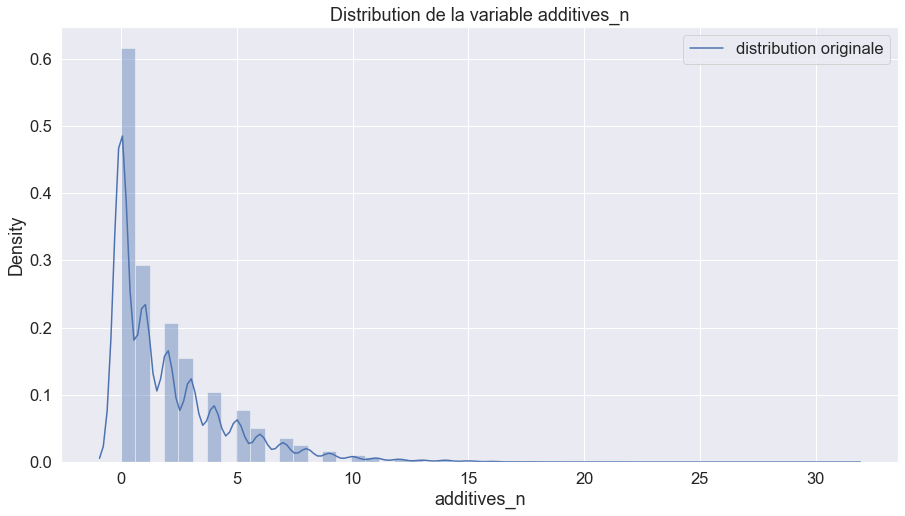

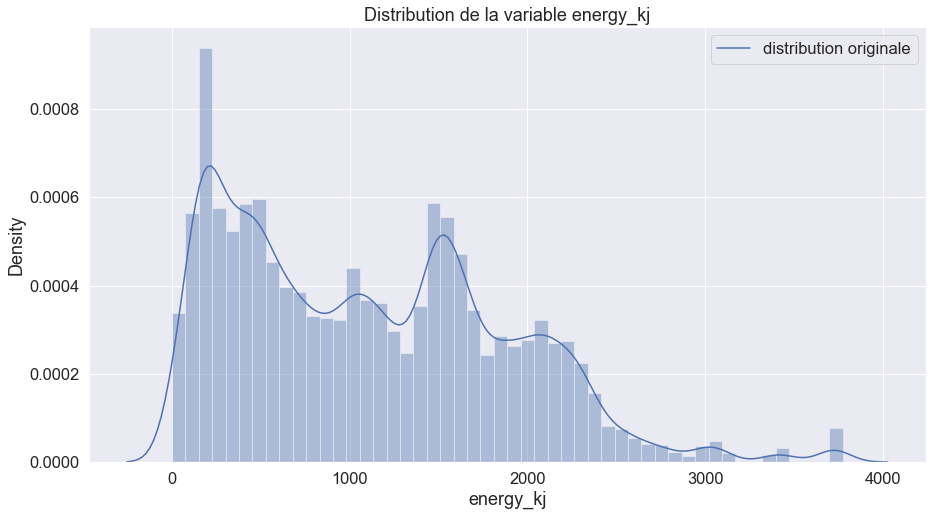

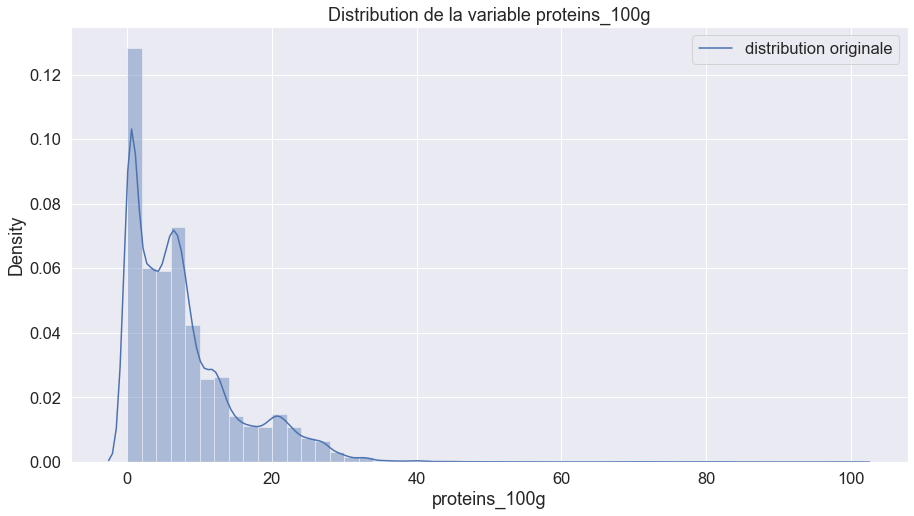

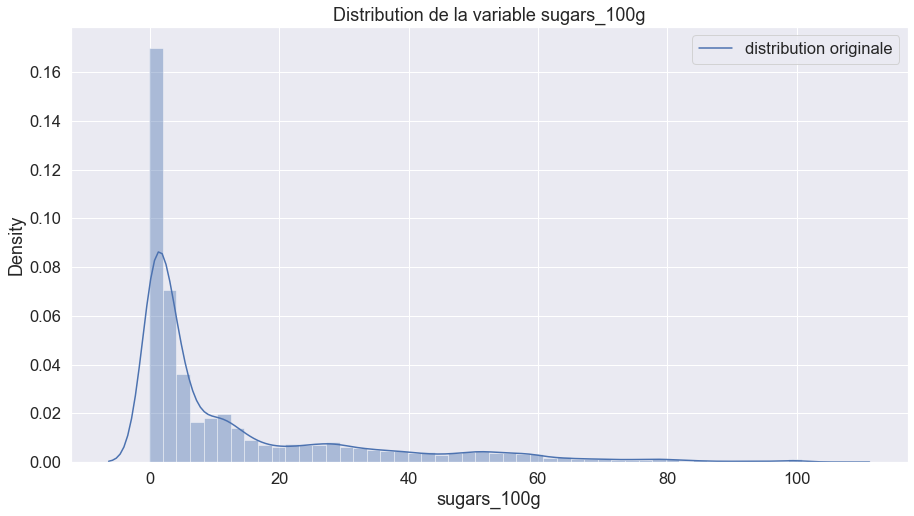

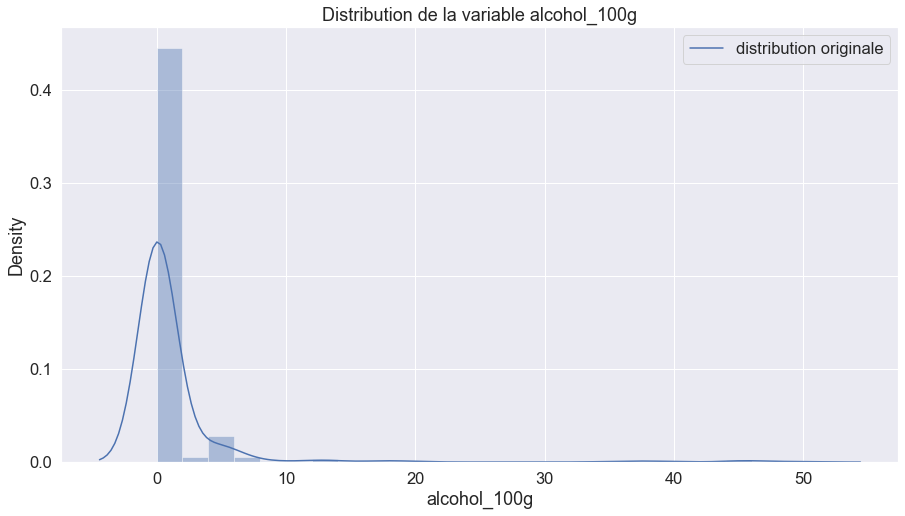

...

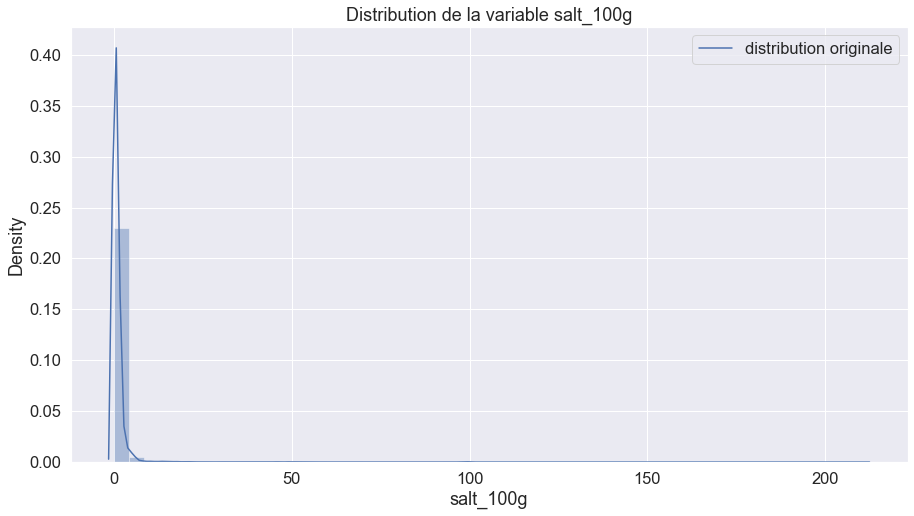

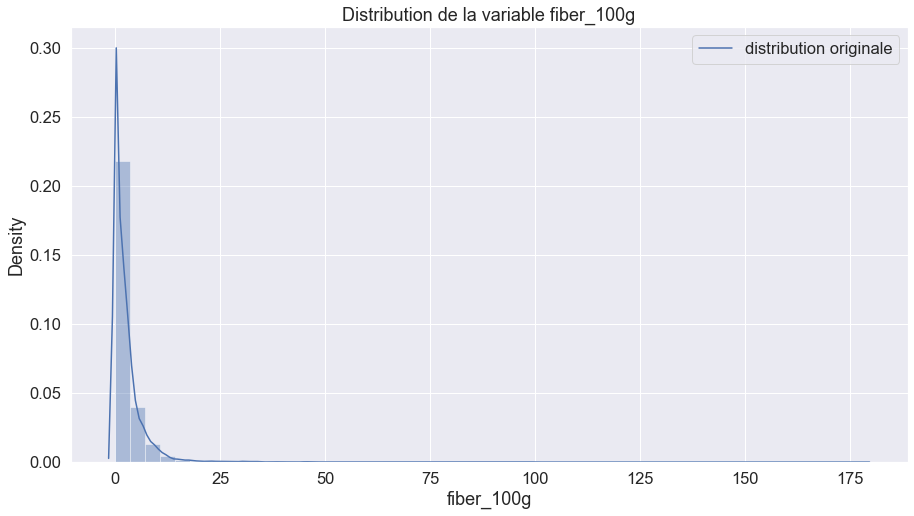

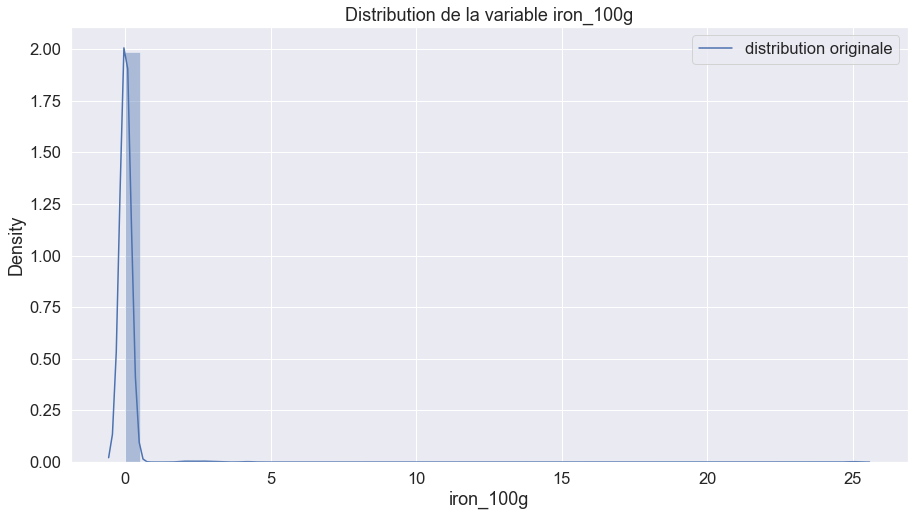

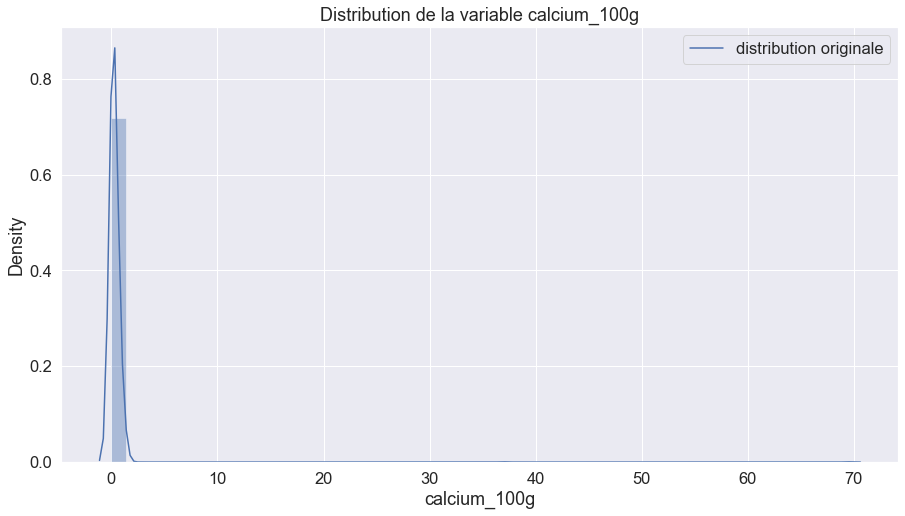

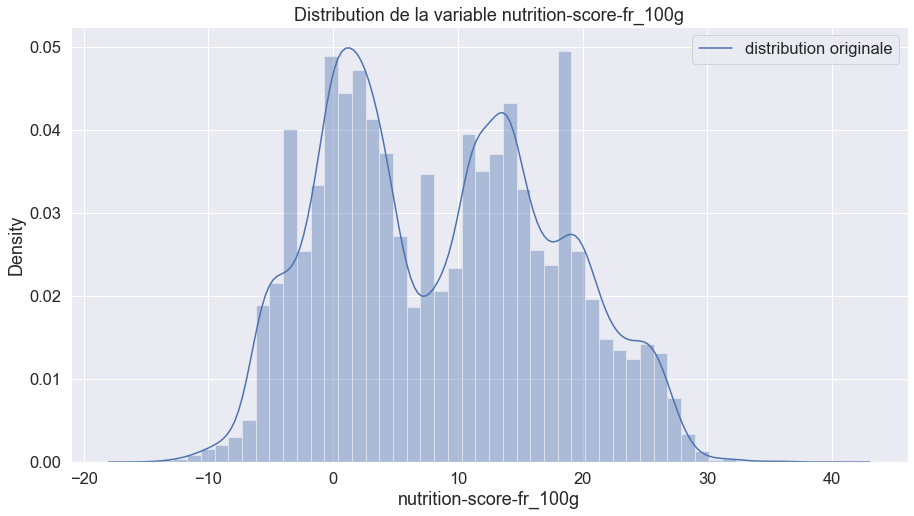

In [318]:
sns.set(font_scale=1.5)
for column in data_graph.columns:
    plt.figure(figsize=(15,8))
    chaine = 'Distribution de la variable ' + column
    plt.title(chaine)
    
    sns.distplot(data_graph[column])
    plt.legend(['distribution originale'])
    print('\nTraitement de la variable ',column)
    print('Moyenne  : ', data_graph[column].mean())
    print('Median  : ', data_graph[column].median())
    print('Max  : ', data_graph[column].max())
    print('Min  : ', data_graph[column].min())

sns.set(font_scale=1)

### une fonction qui permet de nettoyer les colonnes qui se termine avec '100g'

In [617]:
def remove_values_above_100(data):
    # Get list of column names that end with "100g"
    columns_100g = [col for col in data.columns if (col.endswith("_100g"))]

    # Iterate over columns and remove values above 100
    for col in columns_100g:
        data.loc[(data[col] > 100) | (data[col]<0), col] = np.nan

    return data

In [618]:
data_less_outliers = remove_values_above_100(data)

In [619]:
data_less_outliers.dtypes

code                                           object
url                                            object
creator                                        object
created_t                                      object
created_datetime                               object
last_modified_t                                object
last_modified_datetime                         object
product_name                                   object
generic_name                                   object
quantity                                       object
packaging                                      object
packaging_tags                                 object
brands                                         object
brands_tags                                    object
categories                                     object
categories_tags                                object
categories_fr                                  object
origins                                        object
origins_tags                

In [620]:
data_less_outliers.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 63928 entries, 106 to 320763
Columns: 162 entries, code to water-hardness_100g
dtypes: float64(106), object(56)
memory usage: 79.5+ MB


### observer quelques colonnes apres supressions des valeurs abérantes

In [621]:
# creer un dataset avec une liste de  colonne les plus pertinente et ainsi effectuer u,e analyse sur ces colonnes
data_less_out = data_less_outliers[["energy_kj","proteins_100g","sugars_100g",
                          "fat_100g" ,"saturated-fat_100g", "carbohydrates_100g","salt_100g",
                                    "fiber_100g","iron_100g","calcium_100g",
                            "nutrition-score-fr_100g"]]

In [622]:
data_less_out.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 63928 entries, 106 to 320763
Data columns (total 11 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   energy_kj                63928 non-null  float64
 1   proteins_100g            63602 non-null  float64
 2   sugars_100g              61783 non-null  float64
 3   fat_100g                 46608 non-null  float64
 4   saturated-fat_100g       61720 non-null  float64
 5   carbohydrates_100g       46566 non-null  float64
 6   salt_100g                61818 non-null  float64
 7   fiber_100g               45245 non-null  float64
 8   iron_100g                1131 non-null   float64
 9   calcium_100g             2097 non-null   float64
 10  nutrition-score-fr_100g  50541 non-null  float64
dtypes: float64(11)
memory usage: 5.9 MB


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-lev

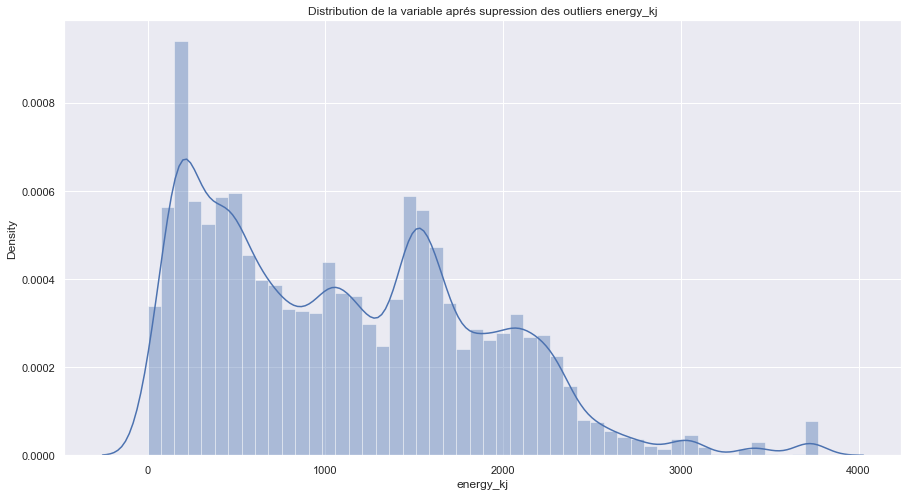

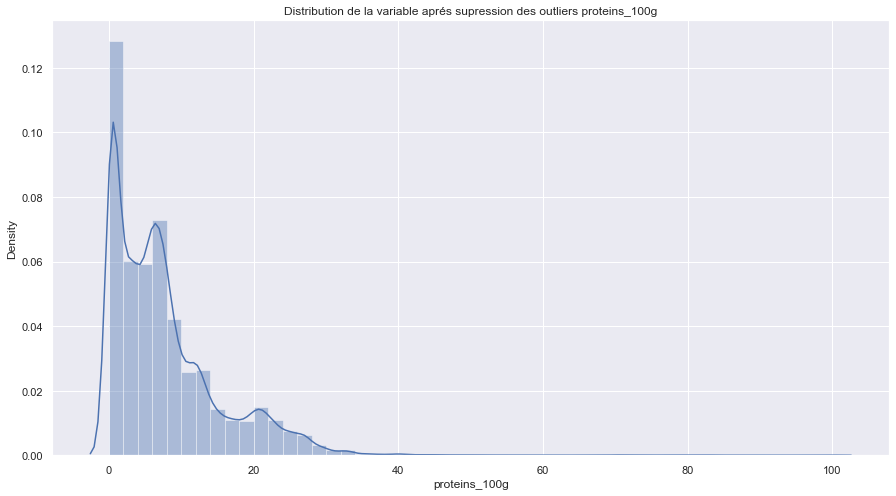

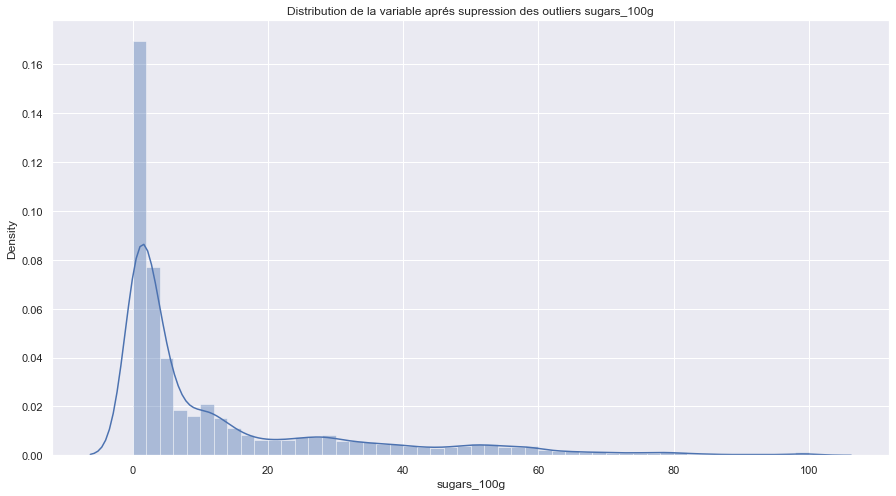

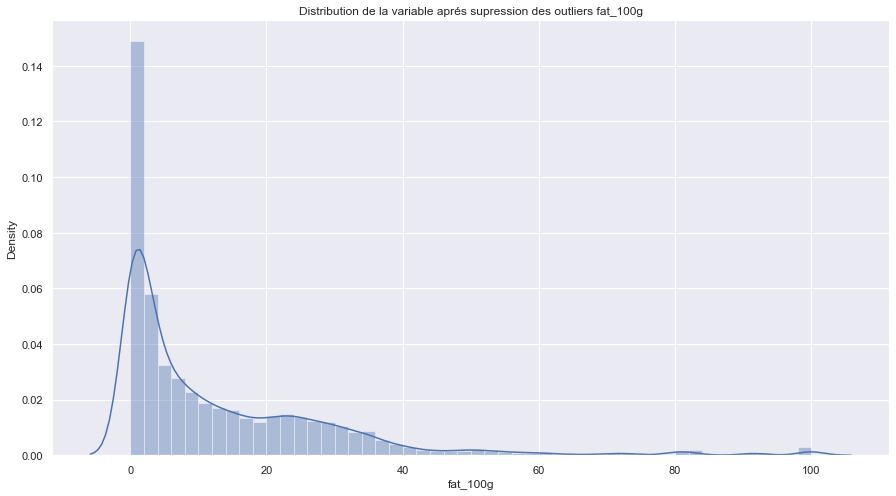

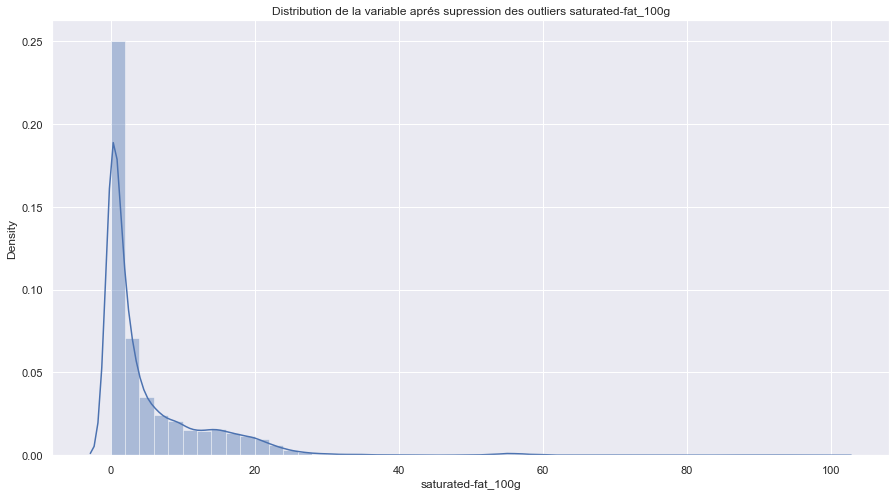

...

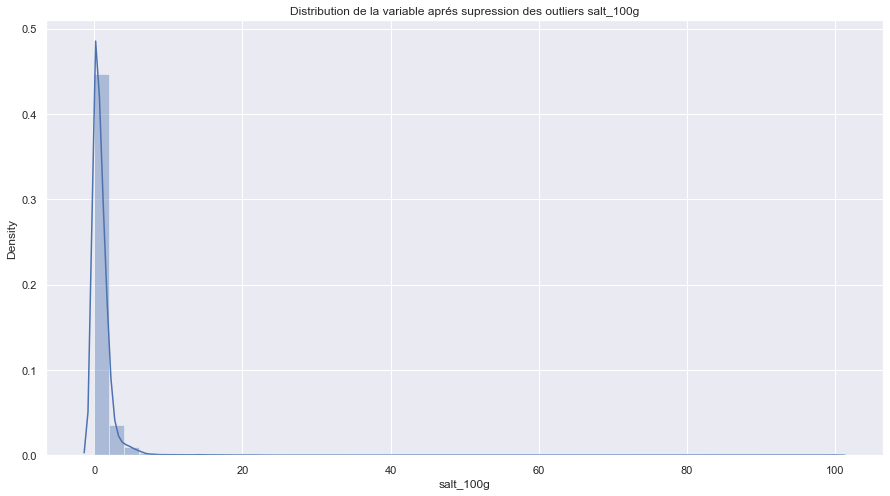

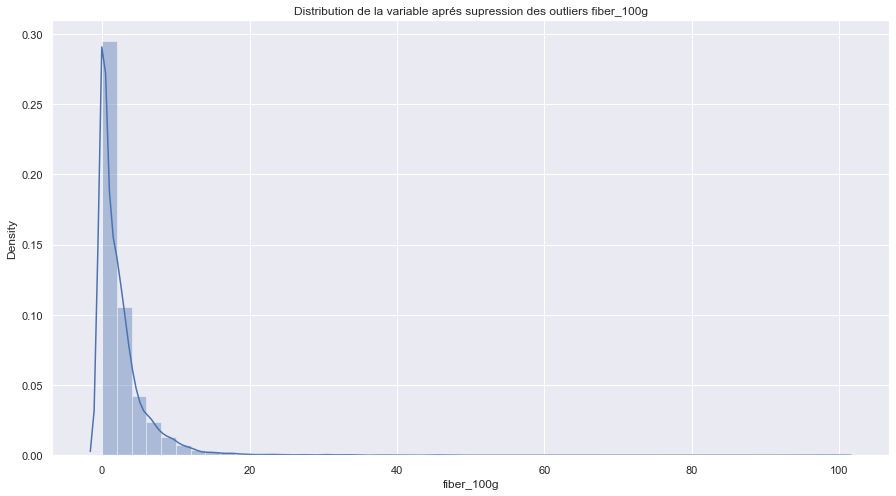

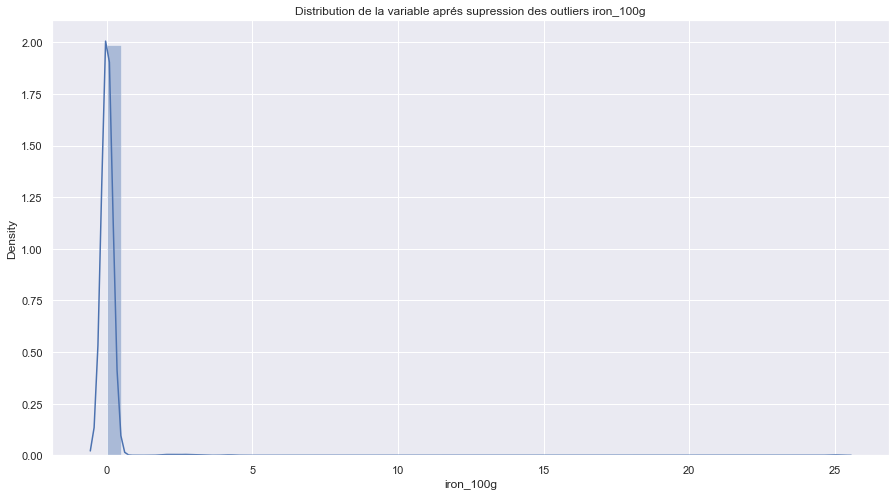

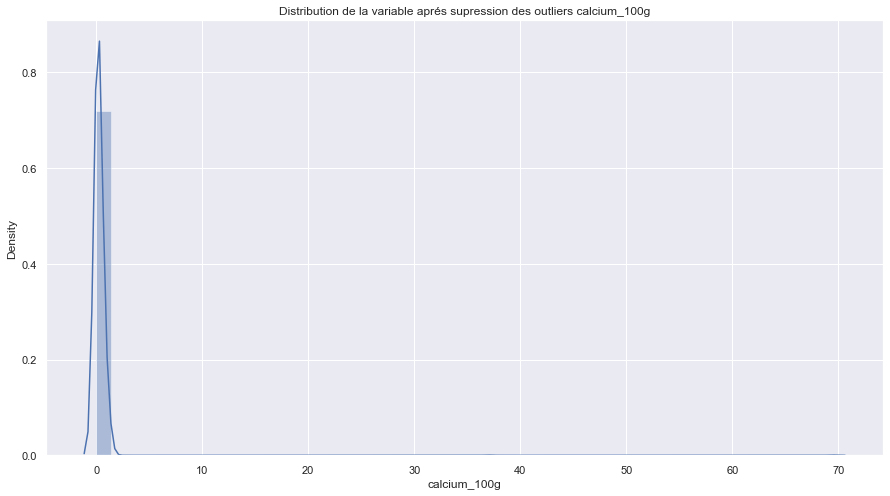

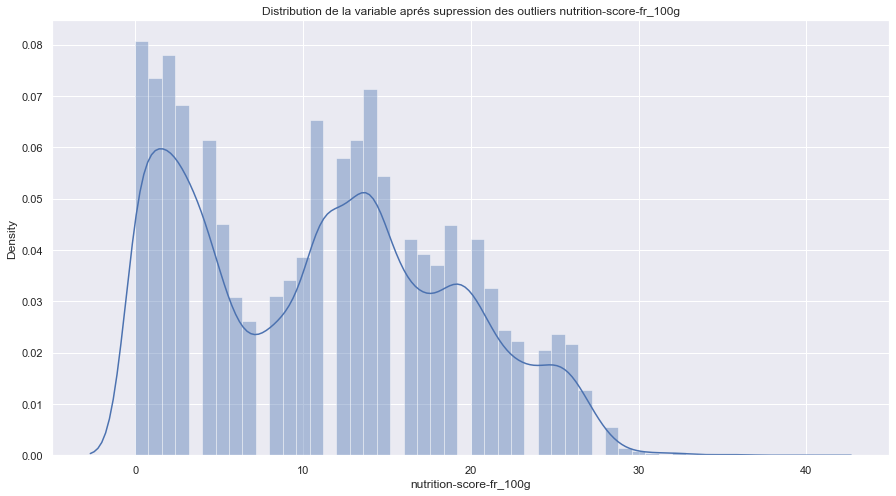

In [623]:
for column in data_less_out.columns:
    plt.figure(figsize=(15,8))
    chaine = 'Distribution de la variable aprés supression des outliers ' + column
    plt.title(chaine)
    
    sns.distplot(data_less_out[column])


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\naoue\anaconda3\lib\si


Traitement de la variable  energy_kj
Moyenne  :  1109.7834358966334
Median  :  1032.0
maximum : 3774.0
min : 0.0

Traitement de la variable  proteins_100g
Moyenne  :  7.753362009056193
Median  :  6.0
maximum : 100.0
min : 0.0

Traitement de la variable  sugars_100g
Moyenne  :  13.321332322483363
Median  :  4.0
maximum : 100.0
min : 0.0

Traitement de la variable  fat_100g
Moyenne  :  13.196102117661791
Median  :  6.7
maximum : 100.0
min : 0.0

Traitement de la variable  saturated-fat_100g
Moyenne  :  5.412952166720627
Median  :  2.0
maximum : 100.0
min : 0.0

Traitement de la variable  carbohydrates_100g
Moyenne  :  27.62097258085301
Median  :  14.3
maximum : 100.0
min : 0.0


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\naoue\anaconda3\lib\si


Traitement de la variable  salt_100g
Moyenne  :  1.1521549894167307
Median  :  0.56
maximum : 100.0
min : 0.0

Traitement de la variable  fiber_100g
Moyenne  :  2.5433089114819394
Median  :  1.3
maximum : 100.0
min : 0.0

Traitement de la variable  iron_100g
Moyenne  :  0.045934179840848834
Median  :  0.005
maximum : 25.0
min : 0.0

Traitement de la variable  calcium_100g
Moyenne  :  0.3218786819265628
Median  :  0.135
maximum : 69.5
min : 0.0

Traitement de la variable  nutrition-score-fr_100g
Moyenne  :  11.147998654557686
Median  :  11.0
maximum : 40.0
min : 0.0


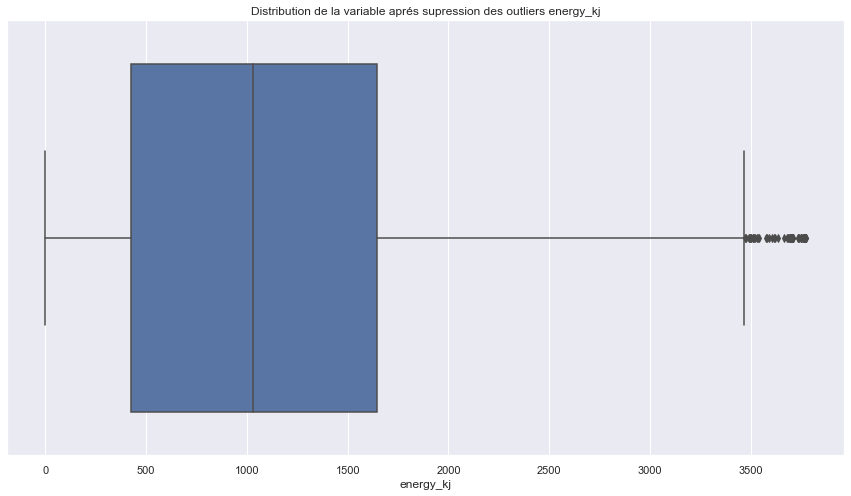

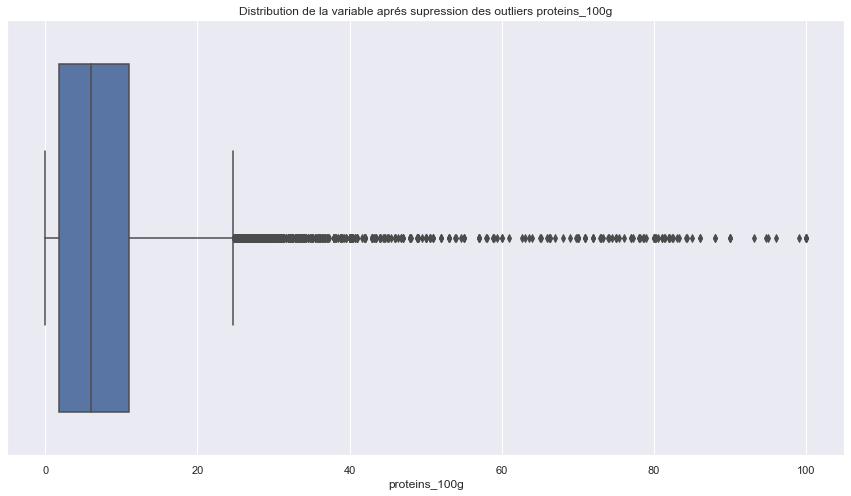

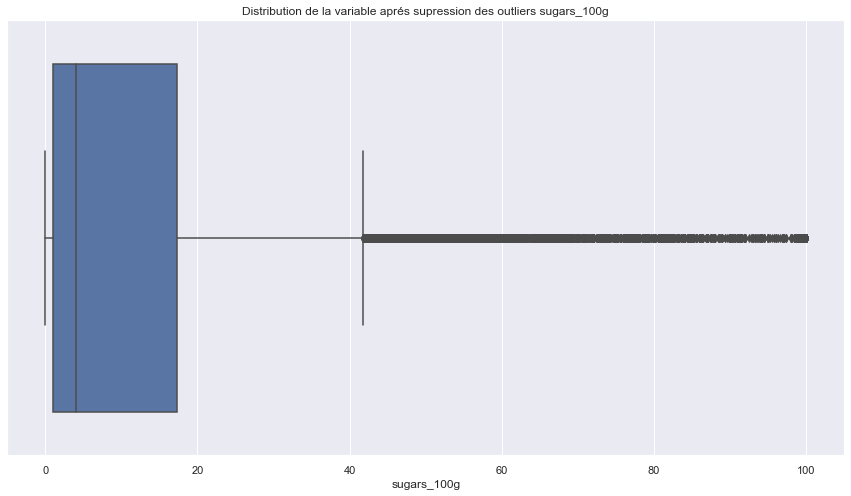

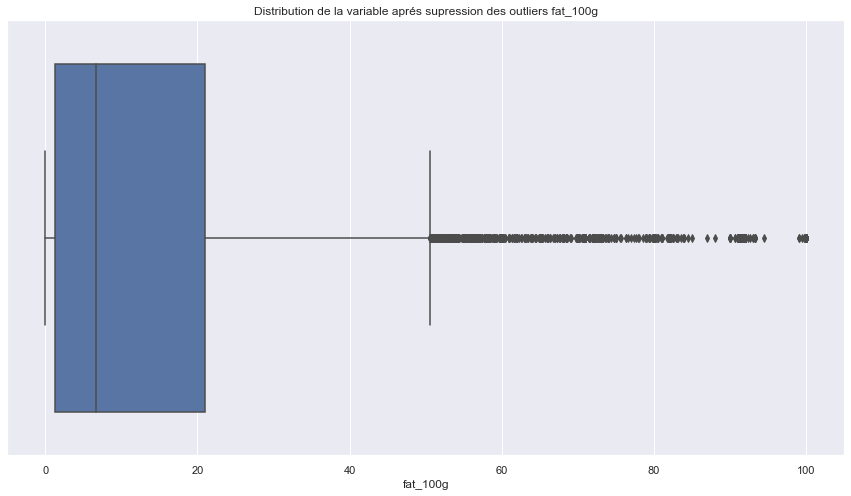

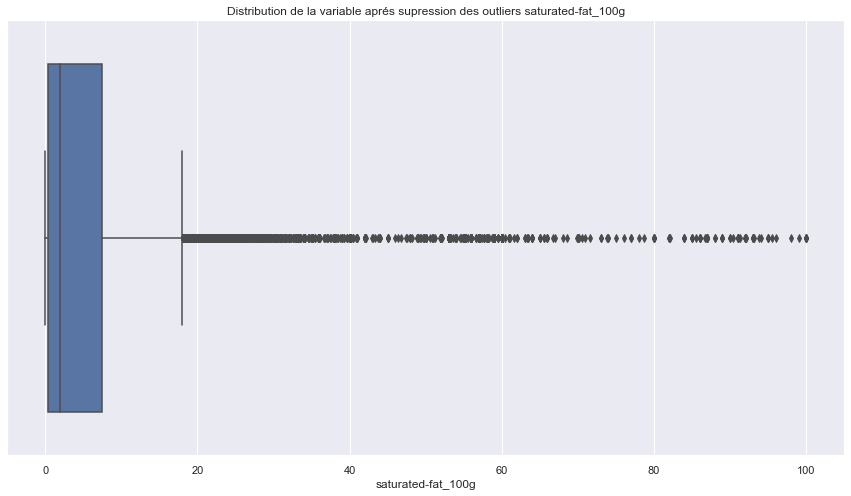

...

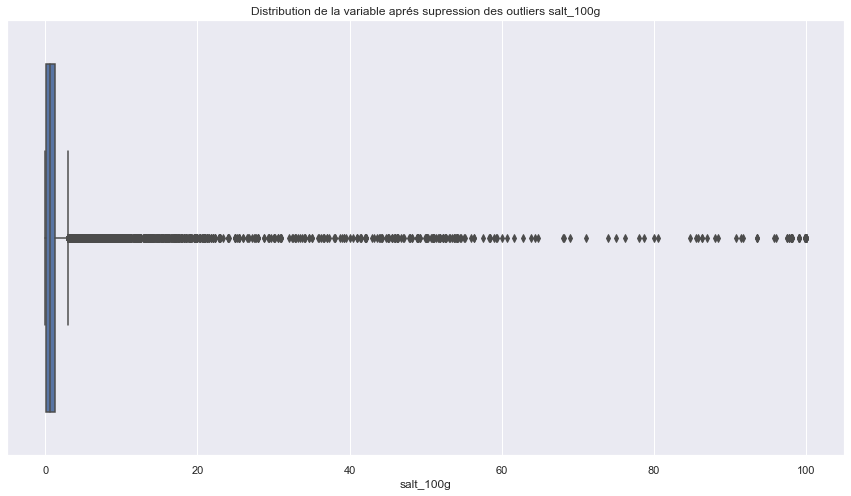

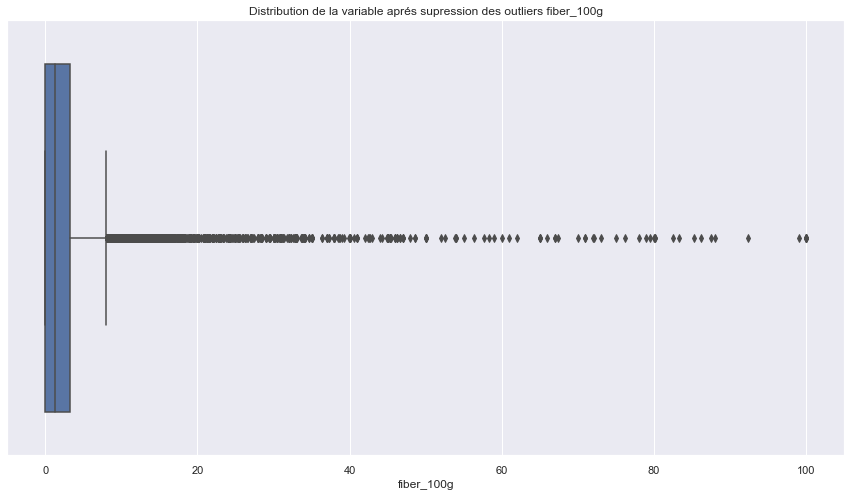

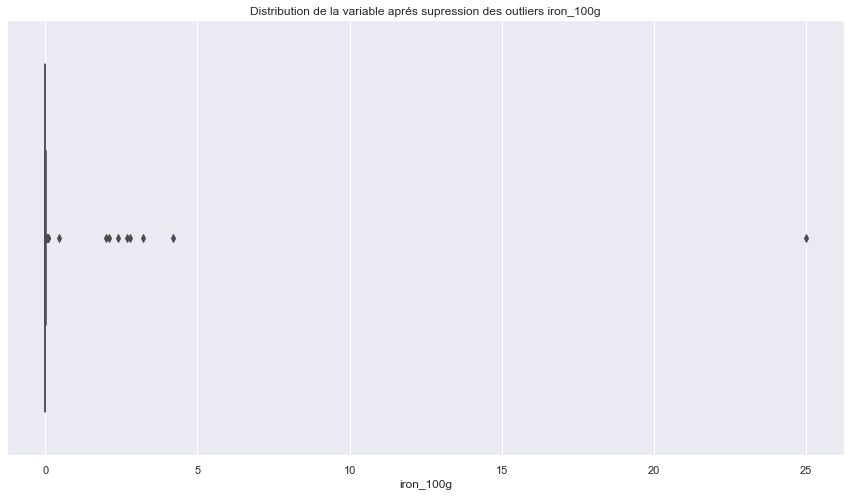

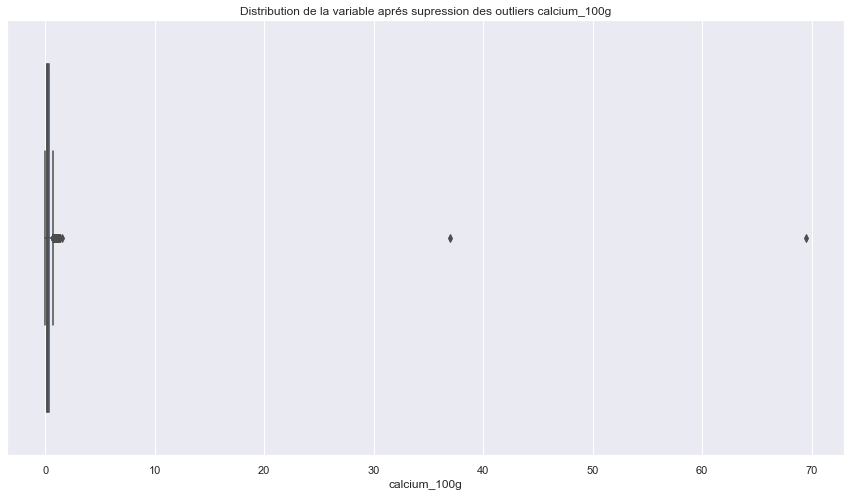

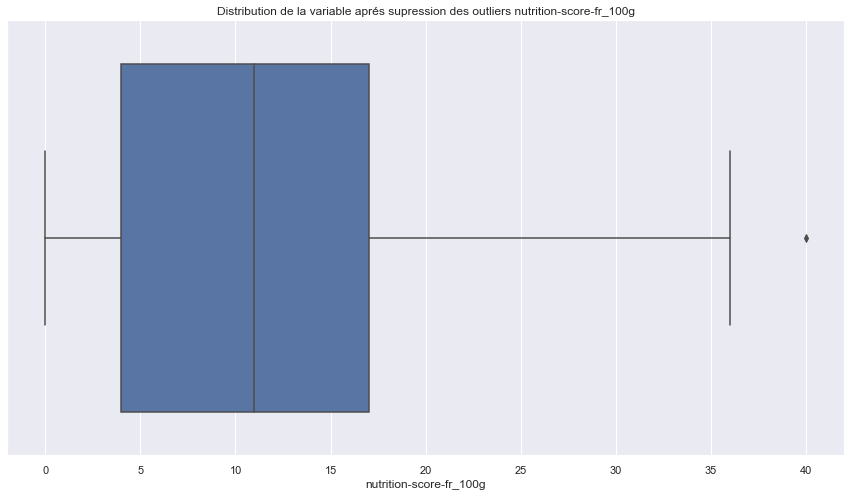

In [326]:
for column in data_less_out.columns:
    plt.figure(figsize=(15,8))
    chaine = 'Distribution de la variable aprés supression des outliers ' + column
    plt.title(chaine)
    
    sns.boxplot(data_less_out[column])
    print('\nTraitement de la variable ',column)
    print('Moyenne  : ', data_less_out[column].mean())
    print('Median  : ', data_less_out[column].median())
    print('maximum :', data_less_out[column].max())
    print('min :', data_less_out[column].min())

sns.set(font_scale=1)

<AxesSubplot:>

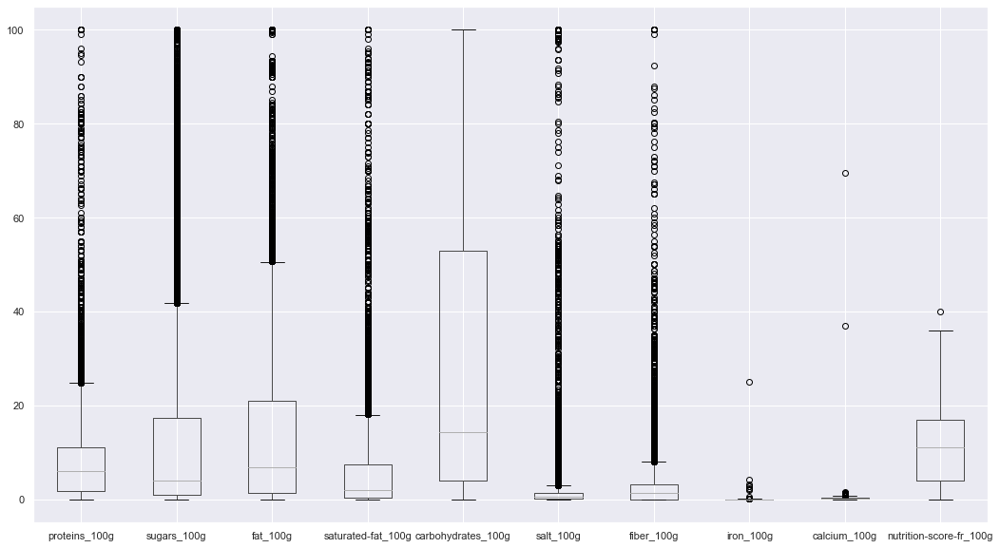

In [624]:

data_less_out.drop("energy_kj", axis = 1).boxplot(figsize=(18,10))

## Analyse bivariée

### nutriscore vs additive

Text(0.5, 1.0, 'le nutri-score vs les additifs')

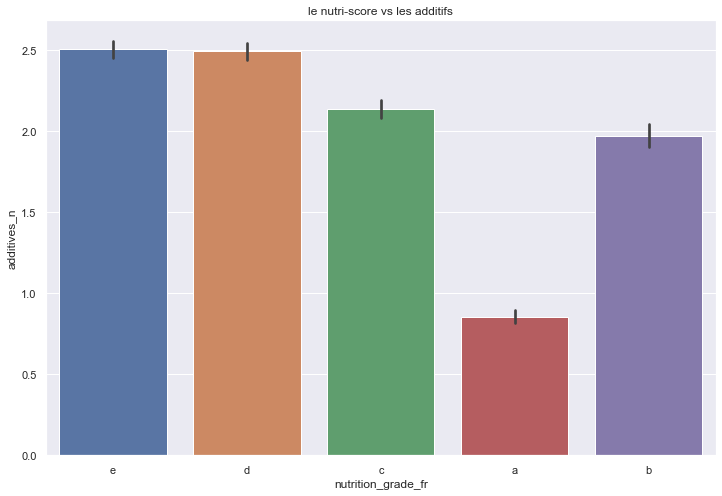

In [625]:
plt.figure(figsize=(12,8))
sns.barplot(x ='nutrition_grade_fr',y ='additives_n', data = data_less_outliers)
plt.title("le nutri-score vs les additifs")


<AxesSubplot:xlabel='additives_n', ylabel='Count'>

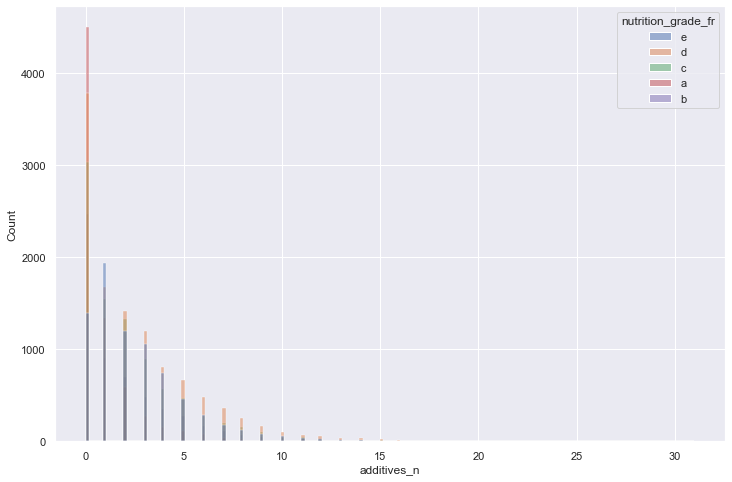

In [626]:
plt.figure(figsize=(12,8))

sns.histplot(data=data_less_outliers, x='additives_n', hue='nutrition_grade_fr', stat='count')

<AxesSubplot:xlabel='nutrition_grade_fr', ylabel='additives_n'>

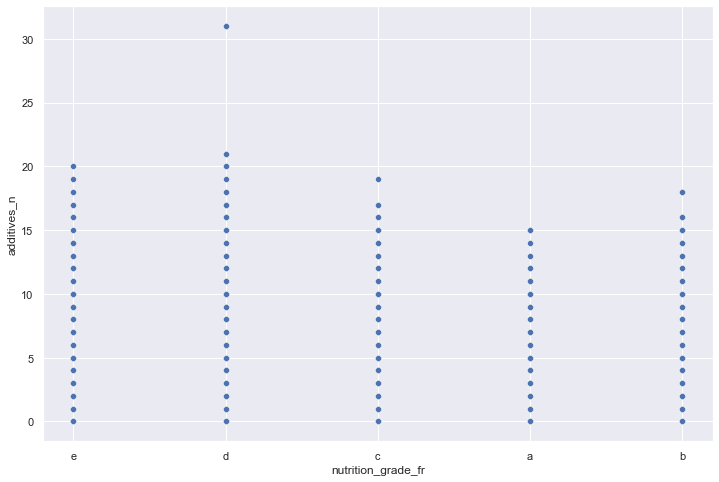

In [627]:
plt.figure(figsize=(12,8))

sns.scatterplot(data = data_less_outliers ,x = "nutrition_grade_fr" ,y ="additives_n" )

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'nutri-score vs les additifs')

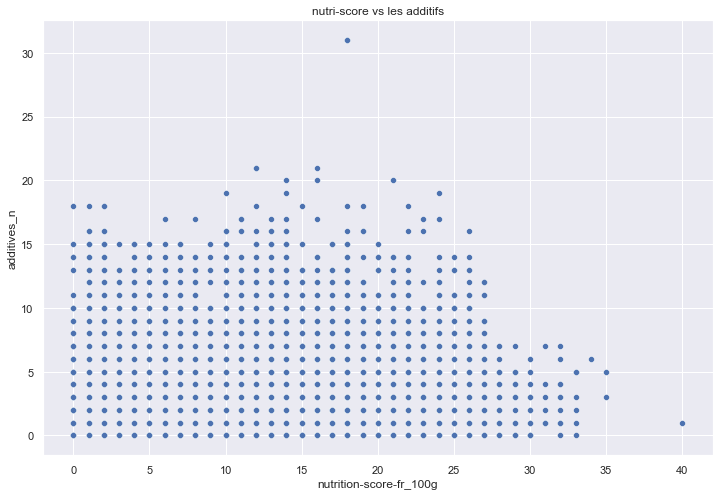

In [505]:
plt.figure(figsize=(12,8))

sns.scatterplot(data_less_outliers['nutrition-score-fr_100g'], data_less_outliers['additives_n'] )
plt.title('nutri-score vs les additifs')

### nutriscore vs sucre

Text(0.5, 1.0, 'le nutri-score vs sugar')

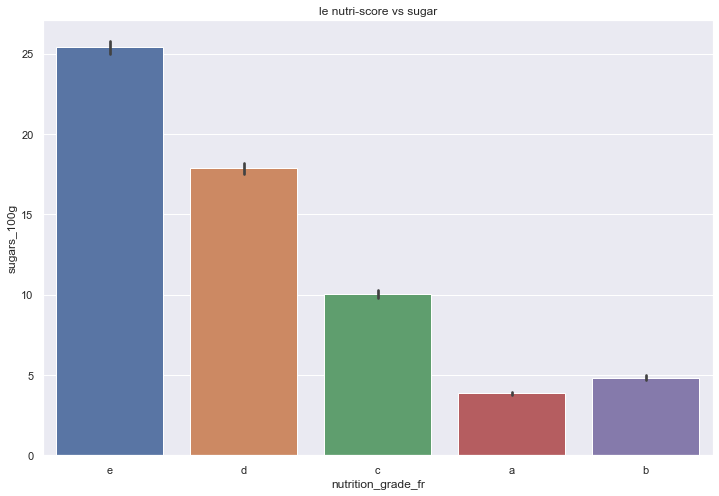

In [332]:
plt.figure(figsize=(12,8))
sns.barplot(x ='nutrition_grade_fr',y ='sugars_100g', data = data_less_outliers)
plt.title("le nutri-score vs sugar")

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'nutri-score vs le sucre')

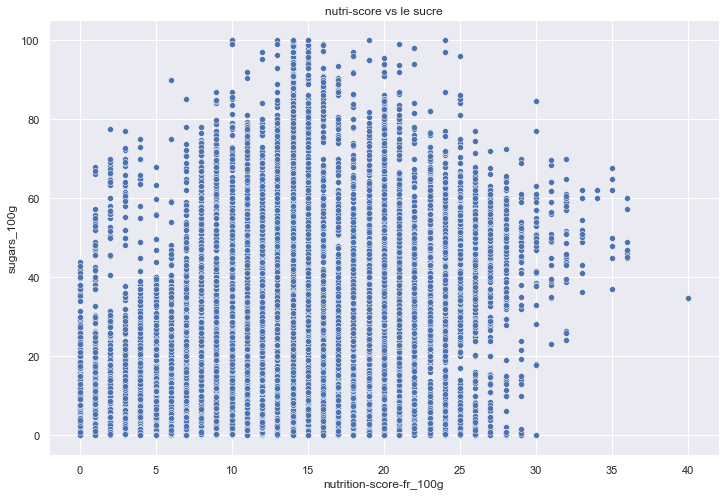

In [333]:
plt.figure(figsize=(12,8))

sns.scatterplot(data_less_outliers['nutrition-score-fr_100g'], data_less_outliers['sugars_100g'] )
plt.title("nutri-score vs le sucre")

<AxesSubplot:xlabel='sugars_100g', ylabel='Count'>

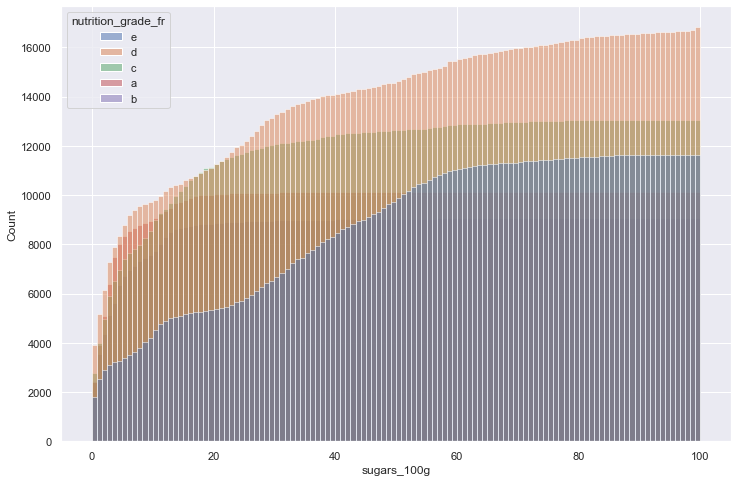

In [334]:
plt.figure(figsize=(12,8))

sns.histplot(data=data_less_outliers, x='sugars_100g', hue='nutrition_grade_fr', stat='count', cumulative= True)

### nutriscore vs gras saturé

Text(0.5, 1.0, 'le nutri-score vs saturated fat')

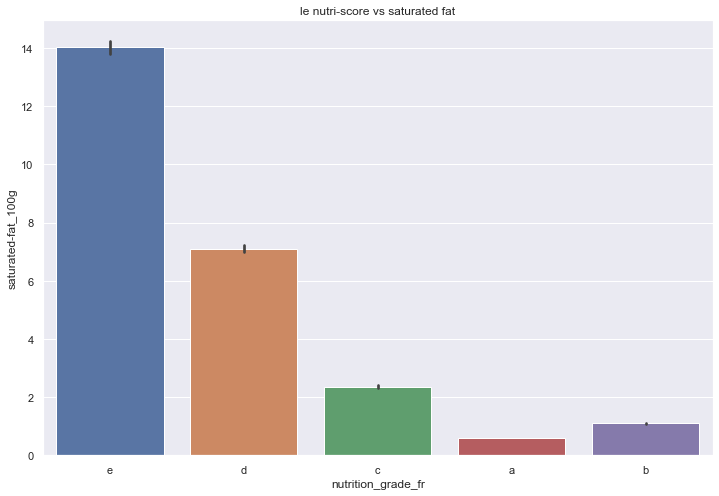

In [335]:
plt.figure(figsize=(12,8))
sns.barplot(x ='nutrition_grade_fr',y ='saturated-fat_100g', data = data_less_outliers)
plt.title("le nutri-score vs saturated fat")


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'nutri-score vs le gras saturé')

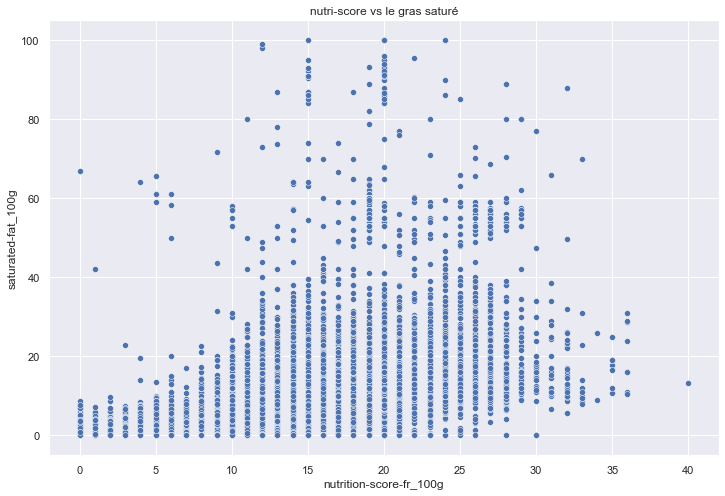

In [336]:
plt.figure(figsize=(12,8))

sns.scatterplot(data_less_outliers['nutrition-score-fr_100g'], data_less_outliers['saturated-fat_100g'] )
plt.title("nutri-score vs le gras saturé")

### nutriscore vs sel

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'nutri-score vs le sel')

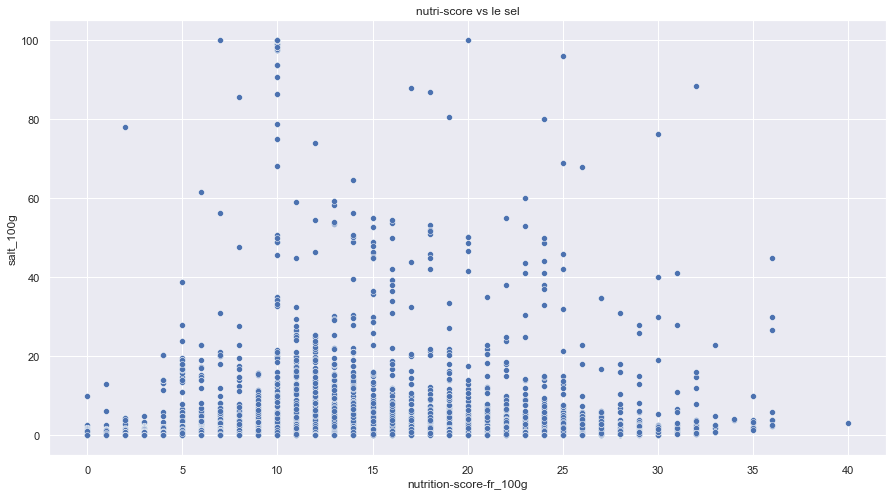

In [337]:
plt.figure(figsize=(15,8))

sns.scatterplot(data_less_outliers['nutrition-score-fr_100g'], data_less_outliers['salt_100g'] )
plt.title("nutri-score vs le sel")

Text(0.5, 1.0, 'le nutri-score vs sel')

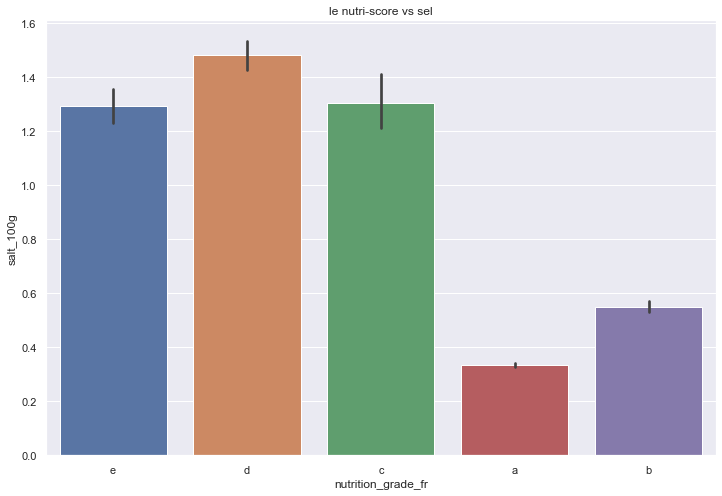

In [338]:
plt.figure(figsize=(12,8))
sns.barplot(x ='nutrition_grade_fr',y ='salt_100g', data = data_less_outliers)
plt.title("le nutri-score vs sel")

### Créer une nouvelle colonne avec la  listedes ingrediens en comptant le nombre d'ingredient


In [628]:
data_less_outliers["ingredients_text"]

106       Milk chocolate coating (evaporated cane juice,...
138                                                     NaN
190                                                     NaN
191                                                     NaN
226       Eau gazéifiée, sucre, colorant caramel E150d, ...
234                                                     NaN
240       Eau gazéifiée, sucre, acidifiants (acide citri...
242       Farine de _blé_, huile de colza, sucre, _oeufs...
279       Farine de _blé_, _œufs_ frais, huile de colza,...
283       Fruits 37.4% [fruits confits 21,5% [fruits (pa...
299       Sucre, blanc d’_œufs_ frais, poudre d’_amande_...
301       Sucre, blanc d’_œufs_ frais, poudre d’_amande_...
307                                                     NaN
428       Pâtisseries fourrées à la pulpe de pêche : far...
452       Sugar, Dextrose, Glucose, Peppermint Flavourin...
454                                                     NaN
456                                     

In [629]:
data_less_outliers['ingredients_text'] = data_less_outliers['ingredients_text'].astype(str)

In [630]:
data_less_outliers["count_ingredient"]= data_less_outliers['ingredients_text'].apply(lambda x: len(x.split(', ')))

In [631]:
data_less_outliers.head()

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g,count_ingredient
106,36252,http://world-fr.openfoodfacts.org/produit/0000...,tacinte,1422221701,2015-01-25T21:35:01Z,1489055667,2017-03-09T10:34:27Z,Lion Peanut x2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,22.0,22.0,NaN,NaN,10
138,39529,http://world-fr.openfoodfacts.org/produit/0000...,teolemon,1420147051,2015-01-01T21:17:31Z,1489055652,2017-03-09T10:34:12Z,Pack de 2 Twix,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
190,10187319,http://world-fr.openfoodfacts.org/produit/0000...,kiliweb,1487325954,2017-02-17T10:05:54Z,1487325954,2017-02-17T10:05:54Z,Mini Confettis,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,14.0,14.0,NaN,NaN,1
191,10207260,http://world-fr.openfoodfacts.org/produit/0000...,kiliweb,1490203031,2017-03-22T17:17:11Z,1490203757,2017-03-22T17:29:17Z,Praliné Amande Et Noisette,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,14.0,14.0,NaN,NaN,1
226,40608754,http://world-fr.openfoodfacts.org/produit/0000...,andre,1345024108,2012-08-15T09:48:28Z,1439141731,2015-08-09T17:35:31Z,"Pepsi, Nouveau goût !",Boisson gazeuse rafraîchissante aux extraits n...,15 cl,...,NaN,NaN,NaN,NaN,NaN,13.0,2.0,NaN,NaN,6


In [632]:
data_less_outliers.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 63928 entries, 106 to 320763
Columns: 163 entries, code to count_ingredient
dtypes: float64(106), int64(1), object(56)
memory usage: 80.0+ MB


### vérifier les résultats

In [633]:
data_less_outliers["count_ingredient"].max()

125

In [634]:
max_row = data_less_outliers.loc[data_less_outliers['count_ingredient'].idxmax()]

In [346]:
max_row

code                                                                              3760197630110
url                                           http://world-fr.openfoodfacts.org/produit/3760...
creator                                                                                teolemon
created_t                                                                            1464719063
created_datetime                                                           2016-05-31T18:24:23Z
last_modified_t                                                                      1479315047
last_modified_datetime                                                     2016-11-16T16:50:47Z
product_name                                  Les Petits Feuilletés - Saumon - Tomate & Poiv...
generic_name                                  Assortiment de feuilletés apéritifs, crus surg...
quantity                                                                                  350 g
packaging                               

In [347]:
data_less_outliers["count_ingredient"].min()

1

In [348]:
min_row = data_less_outliers.loc[data_less_outliers['count_ingredient'].idxmin()]

In [349]:
min_row

code                                                                                      39529
url                                           http://world-fr.openfoodfacts.org/produit/0000...
creator                                                                                teolemon
created_t                                                                            1420147051
created_datetime                                                           2015-01-01T21:17:31Z
last_modified_t                                                                      1489055652
last_modified_datetime                                                     2017-03-09T10:34:12Z
product_name                                                                     Pack de 2 Twix
generic_name                                                                                NaN
quantity                                                                                    NaN
packaging                               

### observer la relation entre count ingredients et nutri score

<AxesSubplot:xlabel='count_ingredient', ylabel='Percent'>

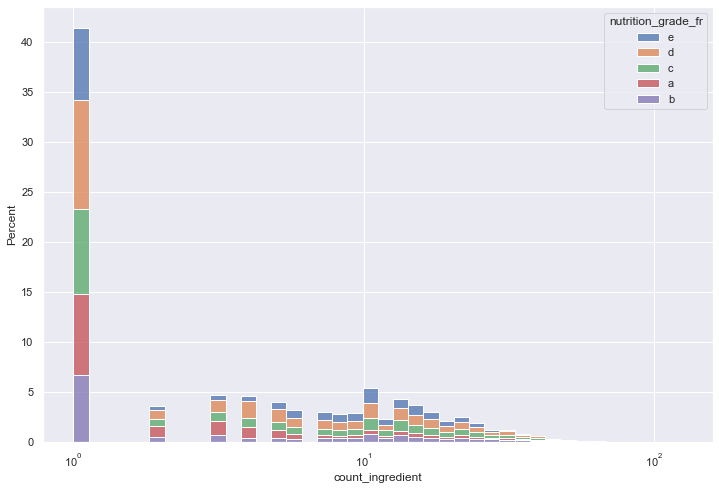

In [635]:
plt.figure(figsize=(12,8))

sns.histplot(data=data_less_outliers, x='count_ingredient', hue='nutrition_grade_fr', stat='percent', multiple='stack', log_scale = True)

<AxesSubplot:xlabel='count_ingredient', ylabel='nutrition_grade_fr'>

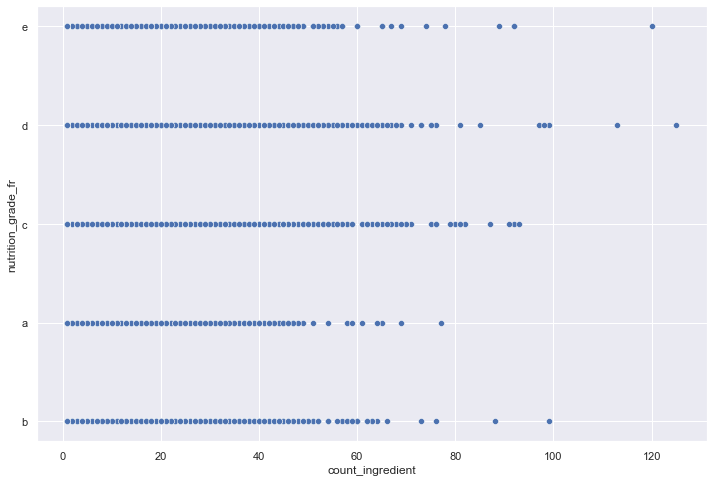

In [636]:
plt.figure(figsize=(12,8))

sns.scatterplot(data = data_less_outliers ,x = "count_ingredient" ,y ="nutrition_grade_fr" )

<AxesSubplot:xlabel='nutrition-score-fr_100g', ylabel='count_ingredient'>

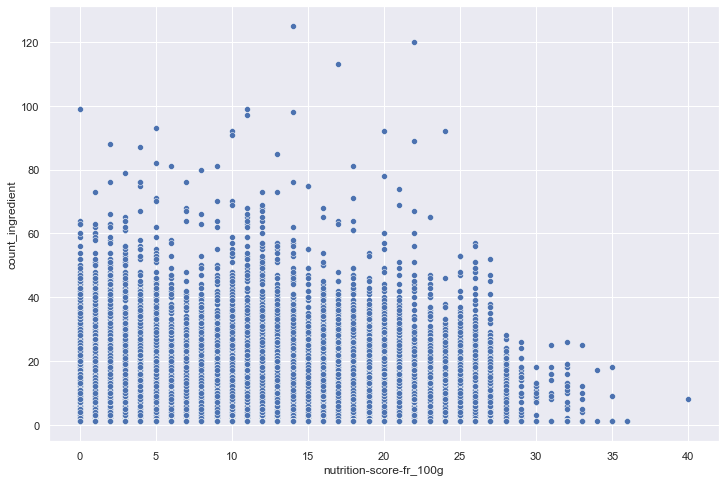

In [352]:
plt.figure(figsize=(12,8))

sns.scatterplot(data = data_less_outliers ,x = "nutrition-score-fr_100g", y = "count_ingredient" )

Text(0.5, 1.0, 'le nutri-score vs count ingredient')

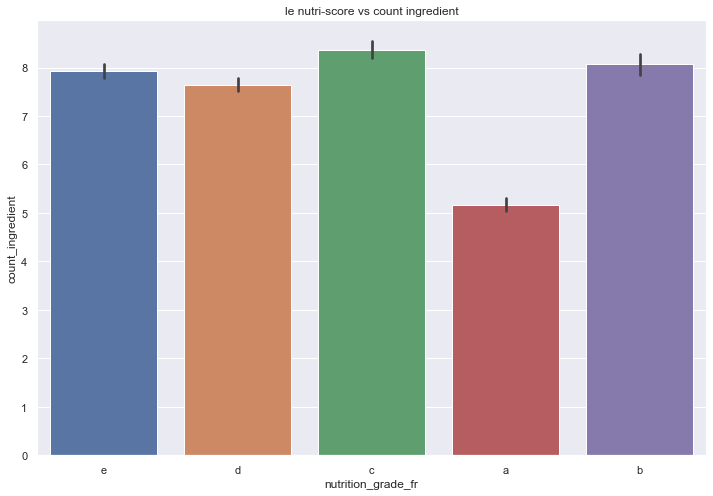

In [353]:
plt.figure(figsize=(12,8))
sns.barplot(x ='nutrition_grade_fr',y ='count_ingredient', data = data_less_outliers)
plt.title("le nutri-score vs count ingredient")

In [637]:
data['count_ingredient'].corr(data['nutrition-score-fr_100g'])

0.004598878475404922

### observer la correlation entre quelque colonnes 

In [513]:
data_corr = data_less_outliers[["energy_kj","proteins_100g","sugars_100g",
                          "fat_100g" ,"saturated-fat_100g", "carbohydrates_100g","salt_100g",
                                    "fiber_100g","iron_100g","calcium_100g",
                            "nutrition-score-fr_100g","count_ingredient"]]

In [514]:
data_corr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 63928 entries, 106 to 320763
Data columns (total 12 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   energy_kj                63928 non-null  float64
 1   proteins_100g            63602 non-null  float64
 2   sugars_100g              61783 non-null  float64
 3   fat_100g                 46608 non-null  float64
 4   saturated-fat_100g       61720 non-null  float64
 5   carbohydrates_100g       46566 non-null  float64
 6   salt_100g                61818 non-null  float64
 7   fiber_100g               45245 non-null  float64
 8   iron_100g                1131 non-null   float64
 9   calcium_100g             2097 non-null   float64
 10  nutrition-score-fr_100g  50541 non-null  float64
 11  count_ingredient         63928 non-null  int64  
dtypes: float64(11), int64(1)
memory usage: 6.3 MB


<AxesSubplot:title={'center':'Matrice de corrélation de pearson entre les variables'}>

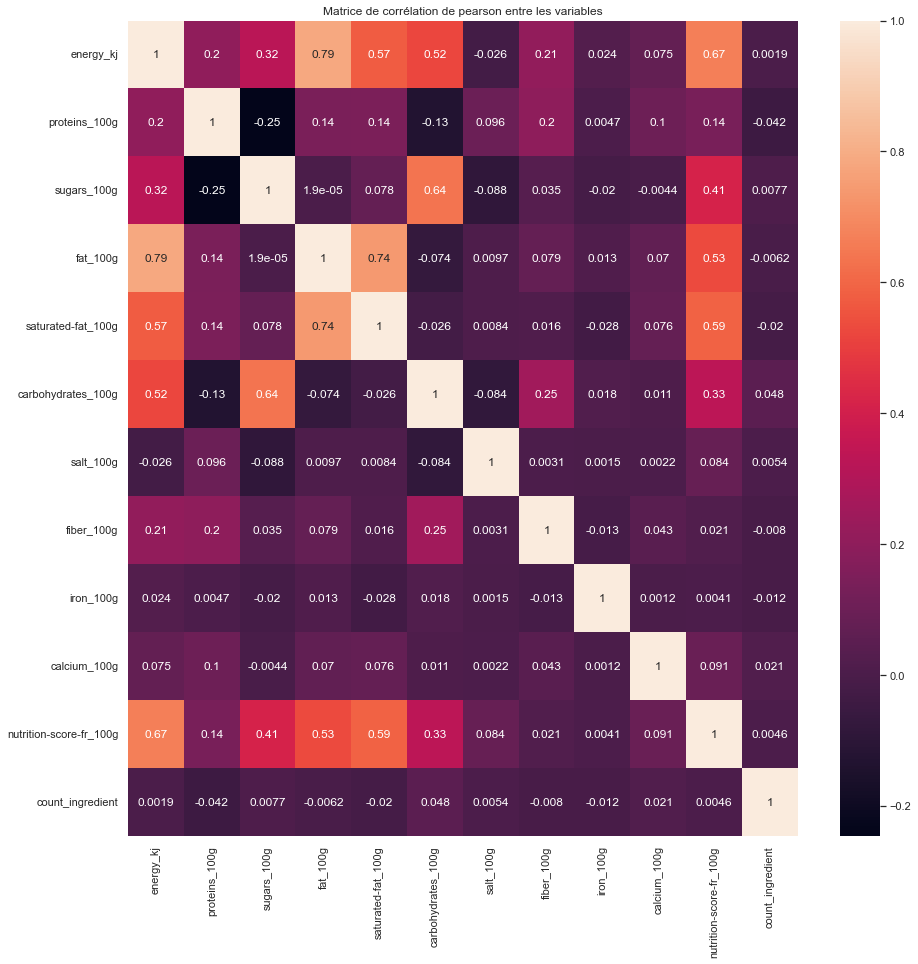

In [515]:
plt.figure(figsize=(15,15))
plt.title('Matrice de corrélation de pearson entre les variables')

corr = data_corr.corr()
sns.heatmap(corr, annot= True)

### 7. Selectionner les variables les plus pertinentes pour l'application

### la completude

In [638]:
data_less_outliers.shape

(63928, 163)

In [639]:
data_coompletion_rate = rate_completion(data_less_outliers)
pd.set_option('display.max_row', None)## visualiser toutes les lignes


In [640]:
data_coompletion_rate

,completion_rate,number_of_missing_data
code,100.00,0
countries,100.00,0
url,100.00,0
energy_kj,100.00,0
states_fr,100.00,0
states_tags,100.00,0
states,100.00,0
ingredients_text,100.00,0
countries_fr,100.00,0
countries_tags,100.00,0


### Effacer les colonnes avec plus de 50% de valeur manquante

### Colonne product name

In [641]:
null_percent = data_less_outliers.isna().mean()

In [642]:
threshold = 0.5

In [643]:
data_new = data_less_outliers.dropna(thresh= len(data_less_outliers) * threshold , axis = 1)
data_new.head()

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,quantity,packaging,...,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,count_ingredient
106,36252,http://world-fr.openfoodfacts.org/produit/0000...,tacinte,1422221701,2015-01-25T21:35:01Z,1489055667,2017-03-09T10:34:27Z,Lion Peanut x2,NaN,NaN,...,12.5,70.00,57.5,2.5,2.50,0.09652,0.038000,22.0,22.0,10
138,39529,http://world-fr.openfoodfacts.org/produit/0000...,teolemon,1420147051,2015-01-01T21:17:31Z,1489055652,2017-03-09T10:34:12Z,Pack de 2 Twix,NaN,NaN,...,NaN,77.08,NaN,6.2,6.25,NaN,NaN,NaN,NaN,1
190,10187319,http://world-fr.openfoodfacts.org/produit/0000...,kiliweb,1487325954,2017-02-17T10:05:54Z,1487325954,2017-02-17T10:05:54Z,Mini Confettis,NaN,NaN,...,0.8,NaN,87.7,0.9,0.60,0.01000,0.003937,14.0,14.0,1
191,10207260,http://world-fr.openfoodfacts.org/produit/0000...,kiliweb,1490203031,2017-03-22T17:17:11Z,1490203757,2017-03-22T17:29:17Z,Praliné Amande Et Noisette,NaN,NaN,...,2.9,NaN,50.3,3.9,9.50,0.00300,0.001181,14.0,14.0,1
226,40608754,http://world-fr.openfoodfacts.org/produit/0000...,andre,1345024108,2012-08-15T09:48:28Z,1439141731,2015-08-09T17:35:31Z,"Pepsi, Nouveau goût !",15 cl,Canette aluminium,...,0.0,10.40,10.4,0.0,0.00,0.02540,0.010000,13.0,2.0,6


In [519]:
data_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 63928 entries, 106 to 320763
Data columns (total 47 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   code                                     63928 non-null  object 
 1   url                                      63928 non-null  object 
 2   creator                                  63928 non-null  object 
 3   created_t                                63928 non-null  object 
 4   created_datetime                         63927 non-null  object 
 5   last_modified_t                          63928 non-null  object 
 6   last_modified_datetime                   63928 non-null  object 
 7   product_name                             63564 non-null  object 
 8   quantity                                 48094 non-null  object 
 9   packaging                                44440 non-null  object 
 10  packaging_tags                           44

### replacement du nutriscore

In [727]:
data_new.isnull().value_counts(subset = ['nutrition-score-fr_100g','nutrition_grade_fr'])

nutrition-score-fr_100g  nutrition_grade_fr
False                    False                 50255
True                     False                 10143
                         True                   3165
dtype: int64

In [728]:
data_new.groupby('nutrition_grade_fr')['nutrition-score-fr_100g'].mean()

nutrition_grade_fr
a     1.046512
b     0.949383
c     5.671742
d    13.802903
e    21.355461
Name: nutrition-score-fr_100g, dtype: float64

In [ ]:
# replacer par ces valeurs le nutrition-score-fr_100g

In [731]:
data_new['nutrition-score-fr_100g'].fillna(data_new.groupby('nutrition_grade_fr')['nutrition-score-fr_100g'].mean()).isnull().sum()

13308

### Vérifier nos résultat

In [644]:
rate_completion(data_new)

,completion_rate,number_of_missing_data
code,100.00,0
countries,100.00,0
energy_kj,100.00,0
states_fr,100.00,0
states_tags,100.00,0
states,100.00,0
url,100.00,0
ingredients_text,100.00,0
countries_fr,100.00,0
countries_tags,100.00,0


### .Regarder la colonne product name et supprimer les lignes sans nom de produits et regarder si nous avons des produits en doublon

In [645]:
data_new = data_new.dropna(subset = ["product_name"])
## supprimer les lignes sans le nom du produit

In [646]:
data_new['product_name'].isnull().sum()

0

### .Regarder les nom de produit qui sont dupliqués

In [647]:
#identifier les duplicates rows
duplicate_product_name = data_new.duplicated(subset=['product_name'])

In [648]:
duplicate_product_name.head()

106    False
138    False
190    False
191    False
226    False
dtype: bool

In [649]:
# Compter le nombre de valeurs NaN dans chaque ligne
nan_counts = data_new.isna().sum(axis=1)

In [650]:
# Supprimer les lignes avec le plus de valeurs NaN
data_new.drop(nan_counts[duplicate_product_name].idxmax(), inplace=True)

In [724]:
nan_counts[duplicate_product_name].idxmax()

215330

In [651]:
data_new.duplicated('product_name').sum()

10502

In [652]:
data_new.shape

(63563, 47)

In [529]:
column_to_drop= ["image_small_url","image_url","url","ingredients_text","creator","created_t",
"countries","countries_tags","countries_fr", "states_tags","packaging","packaging_tags", "pnns_groups_1",
     "pnns_groups_2","purchase_places","additives", "quantity", "brands_tags","categories_tags", "categories",
                 "ingredients_that_may_be_from_palm_oil_n",'nutrition-score-uk_100g']

In [653]:
df_new = data_new.drop(column_to_drop, axis = 1)

In [654]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 63563 entries, 106 to 320763
Data columns (total 25 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   code                         63563 non-null  object 
 1   created_datetime             63562 non-null  object 
 2   last_modified_t              63563 non-null  object 
 3   last_modified_datetime       63563 non-null  object 
 4   product_name                 63563 non-null  object 
 5   brands                       63313 non-null  object 
 6   categories_fr                46852 non-null  object 
 7   additives_n                  43234 non-null  float64
 8   ingredients_from_palm_oil_n  43234 non-null  float64
 9   nutrition_grade_fr           60398 non-null  object 
 10  states                       63563 non-null  object 
 11  states_fr                    63563 non-null  object 
 12  main_category                46852 non-null  object 
 13  main_category

## 8.remplacer les valeurs manquantes avec le Simple imputer, KNNImputer, iterative imputer

<AxesSubplot:title={'center':'Matrice de corrélation de pearson entre les variables'}>

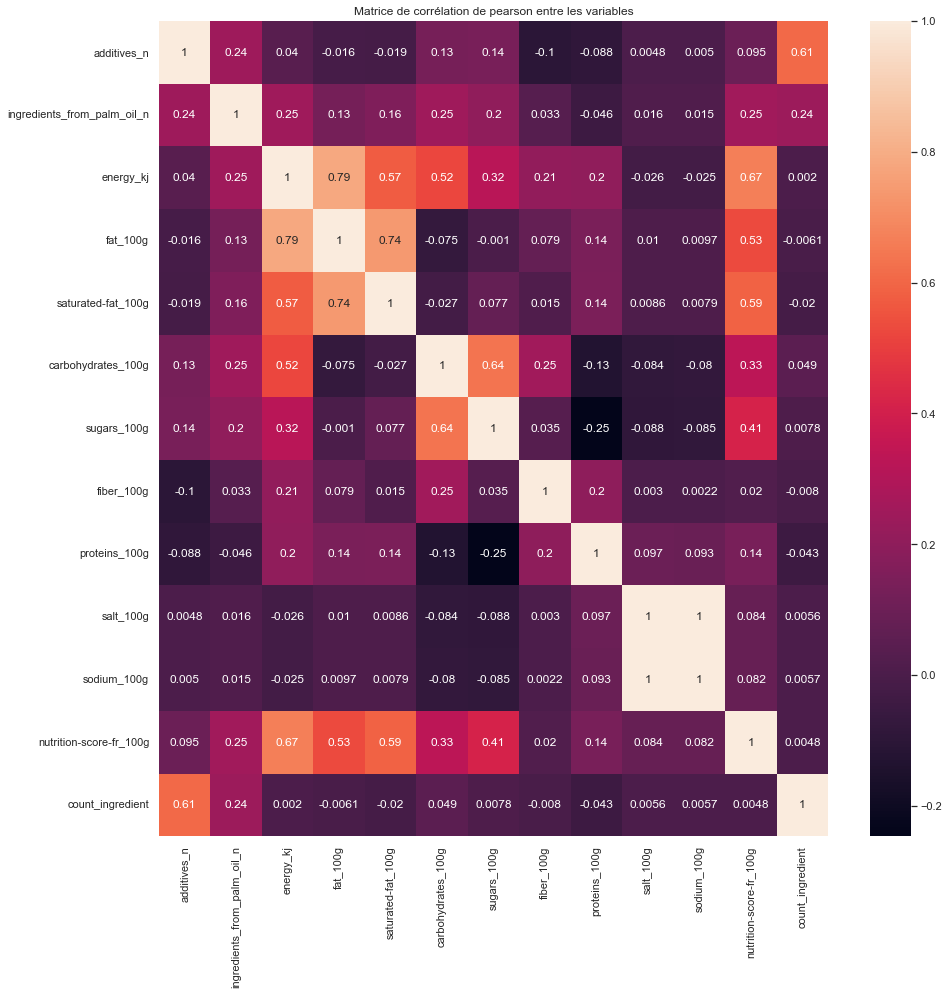

In [377]:
plt.figure(figsize=(15,15))
plt.title('Matrice de corrélation de pearson entre les variables')

corr = df_new.corr()
sns.heatmap(corr, annot= True)

<AxesSubplot:>

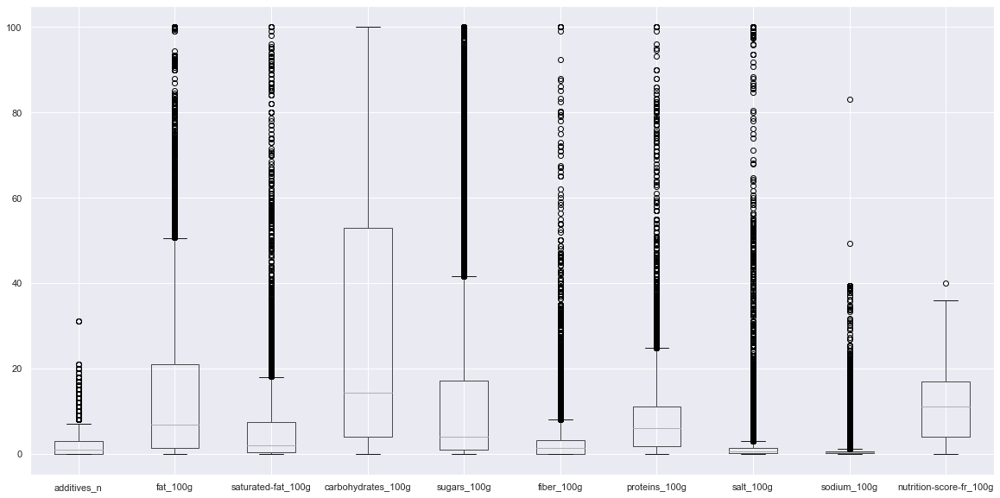

In [378]:

df_new.drop(['energy_kj','ingredients_from_palm_oil_n','count_ingredient'],axis = 1).boxplot(figsize=(20,10))

In [379]:
numeric_data = df_new.select_dtypes(include=['float', 'int']).columns.tolist()
# selection les données numéric pour les visualer
float_df = df_new[numeric_data]

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-lev

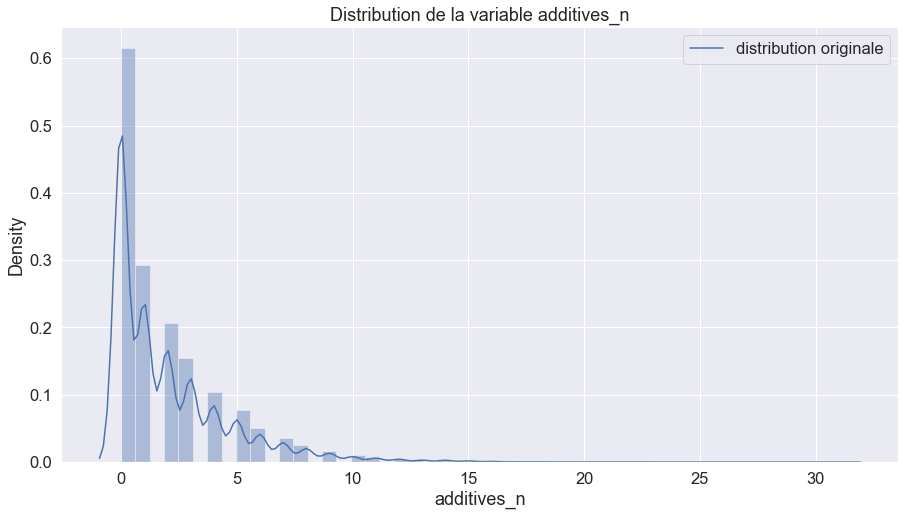

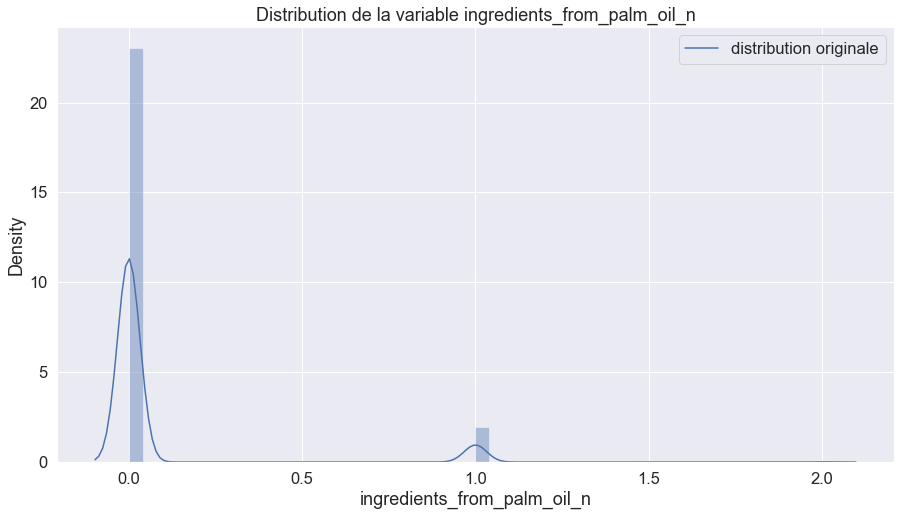

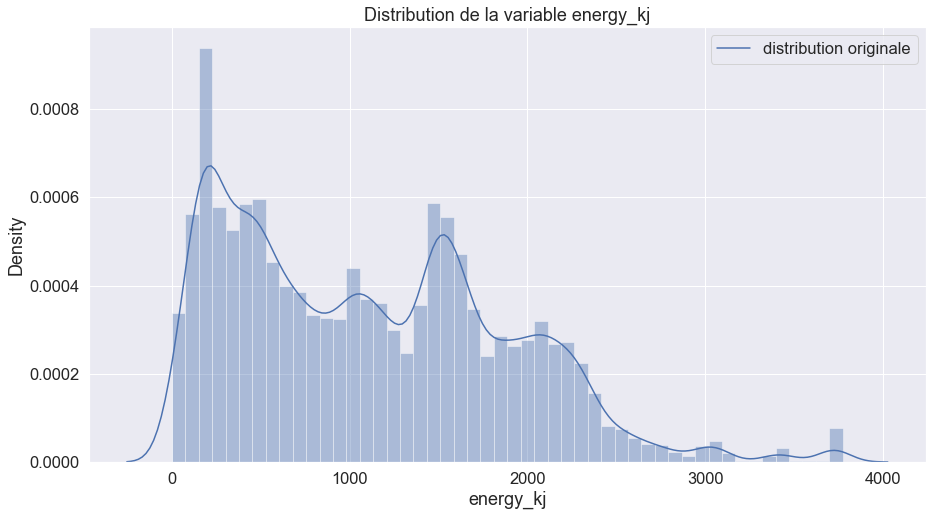

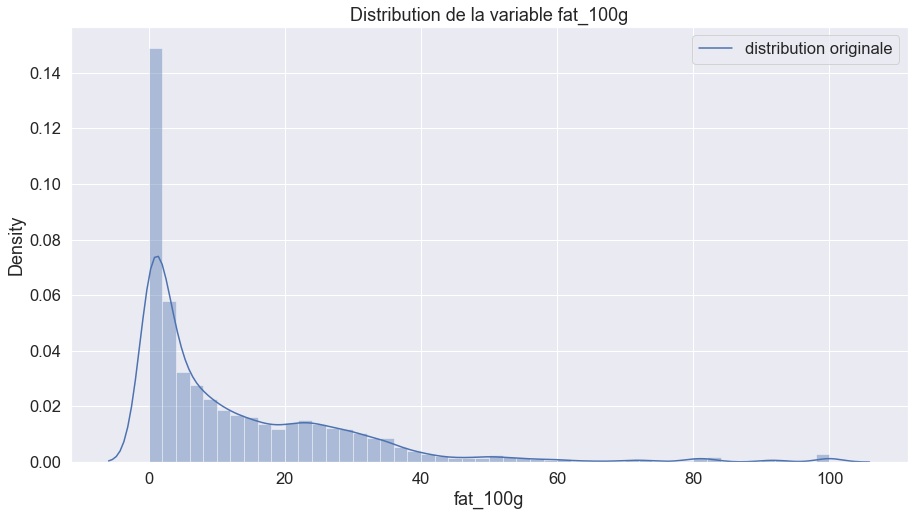

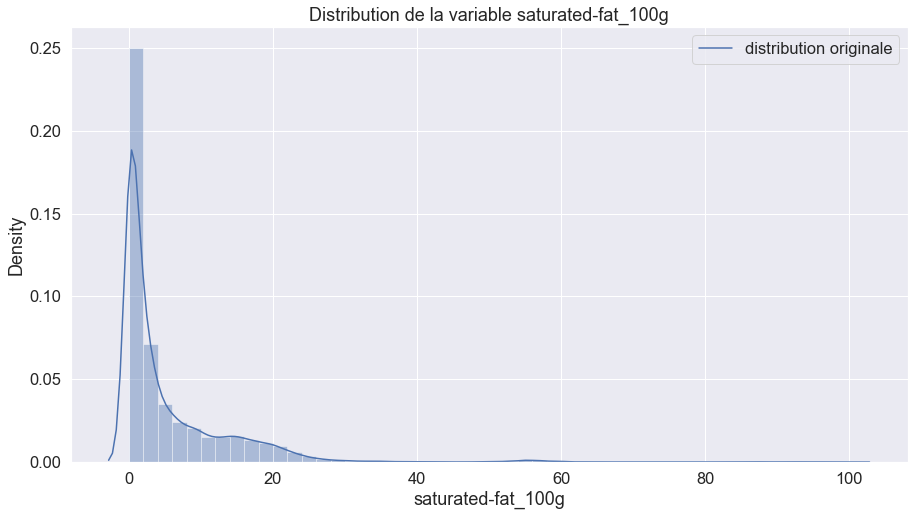

...

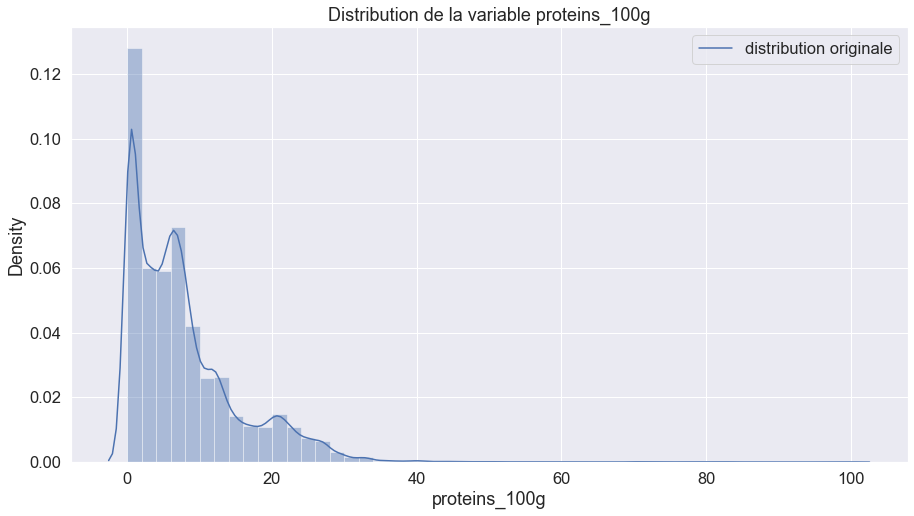

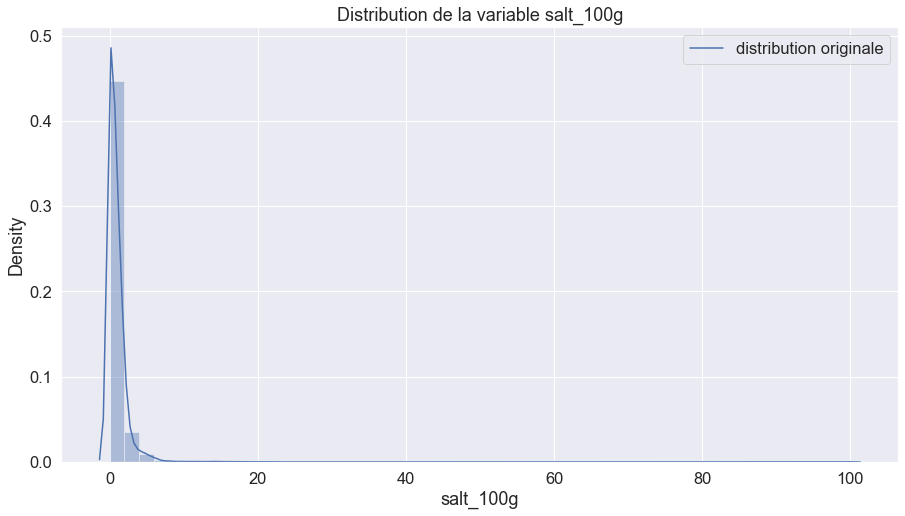

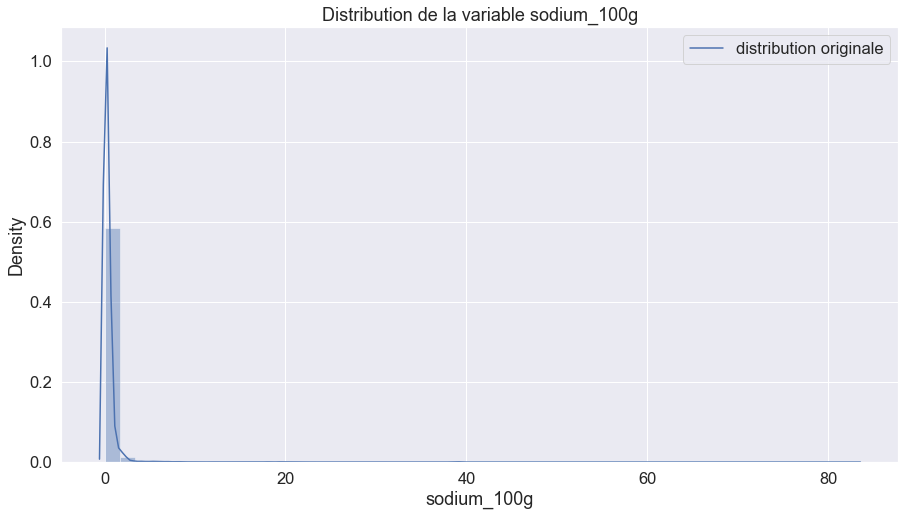

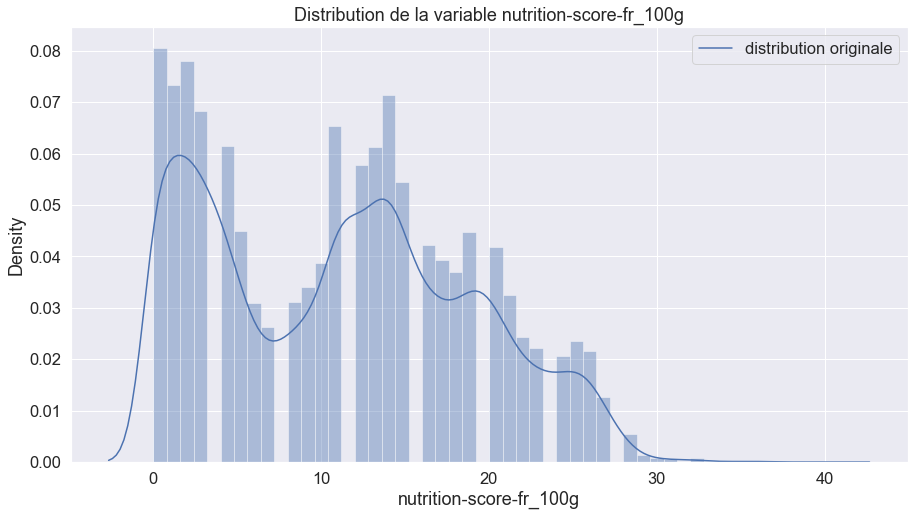

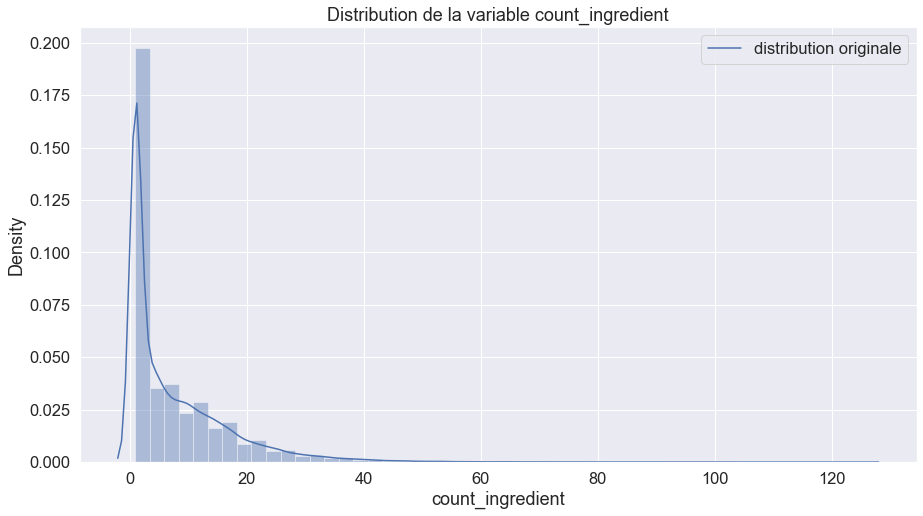

In [380]:
sns.set(font_scale=1.5)
for column in float_df.columns:
    plt.figure(figsize=(15,8))
    chaine = 'Distribution de la variable ' + column
    plt.title(chaine)
    sns.distplot(float_df[column])
    plt.legend(['distribution originale'])
    


sns.set(font_scale=1)

### colonne carbohydrate et  sugar 

<AxesSubplot:xlabel='sugars_100g', ylabel='carbohydrates_100g'>

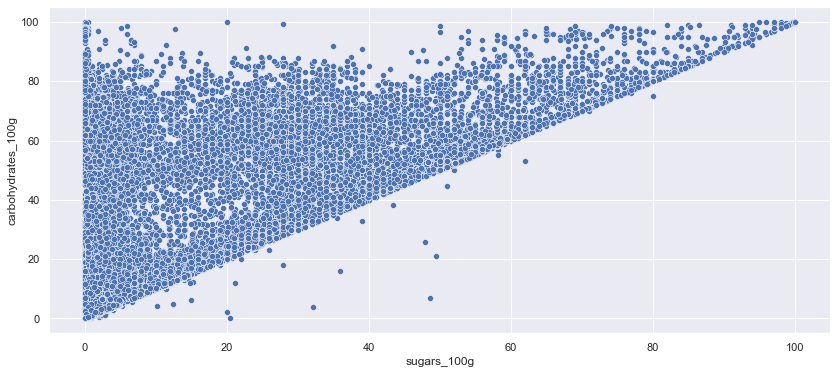

In [381]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'sugars_100g',y= 'carbohydrates_100g')


In [655]:
df_new["sugars_100g"].corr(df_new['carbohydrates_100g'])

0.6394372586175482

### Utiliser iterative  imputer pour  carbohydrate et  sugar 

In [656]:
# créer une instance de IterativeImputer
imputer = IterativeImputer()

In [657]:
imputed_data = imputer.fit_transform(df_new[['sugars_100g', 'carbohydrates_100g']])

In [658]:
df_new[['sugars_100g', 'carbohydrates_100g']]= imputed_data

### Vérifier les résultat aprés le remplacelent des valeurs null

In [659]:
df_new[['sugars_100g', 'carbohydrates_100g']].isnull().sum()

sugars_100g           0
carbohydrates_100g    0
dtype: int64

<AxesSubplot:xlabel='sugars_100g', ylabel='carbohydrates_100g'>

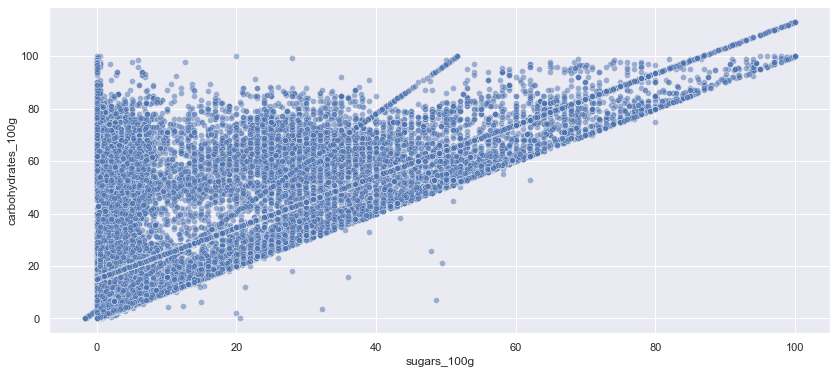

In [725]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'sugars_100g',y= 'carbohydrates_100g',alpha=0.5)

### les colonnes salt et sodium

In [661]:
df_new['salt_100g'].corr(df_new['sodium_100g'])

0.9999999803380587

<AxesSubplot:xlabel='salt_100g', ylabel='sodium_100g'>

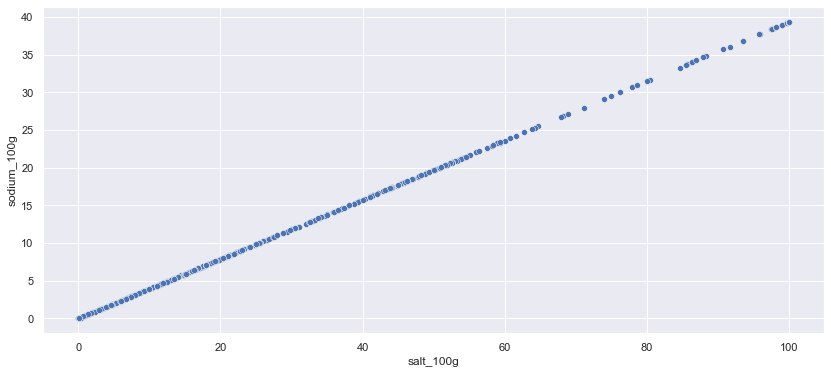

In [662]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'salt_100g',y= 'sodium_100g')

garder la colonne salt
les deux colonne sont trés fortement corrélé et ont le même nombre de valeur manquantes ainsi que des outliers

In [663]:
df_new = df_new.drop("sodium_100g", axis = 1)

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='salt_100g', ylabel='Density'>

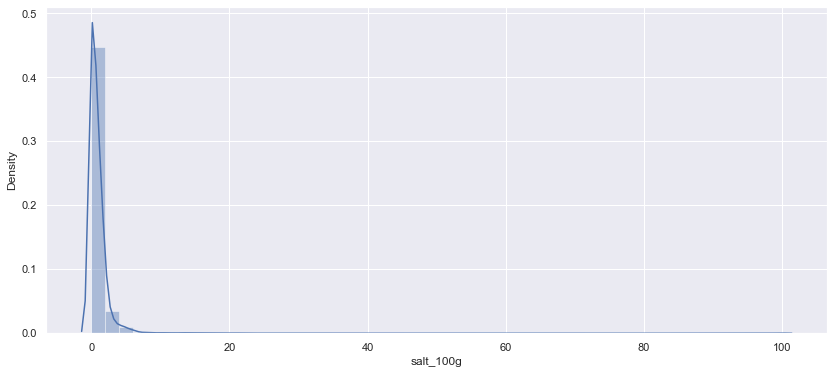

In [664]:
## afficher la distribiution du salt
plt.figure(figsize=(14,6))
sns.distplot(data_new['salt_100g'])


### utiliser simple imputer pour salt avec méthode median

In [665]:
imp_median = SimpleImputer(missing_values=np.nan, strategy='median')

In [666]:
df_new['salt_100g'] = imp_median.fit_transform(df_new['salt_100g'].values.reshape(-1,1))[:,0]

### observer les résultats 

In [667]:
df_new['salt_100g'].isnull().sum()

0

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='salt_100g', ylabel='Density'>

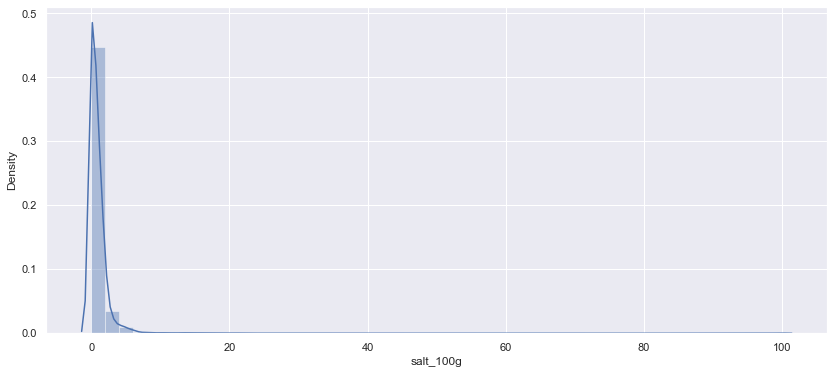

In [668]:
plt.figure(figsize=(14,6))
sns.distplot(data_new['salt_100g'])

### Les colonnes fat_100g , saturated-fat_100g ,energy

<AxesSubplot:xlabel='fat_100g', ylabel='saturated-fat_100g'>

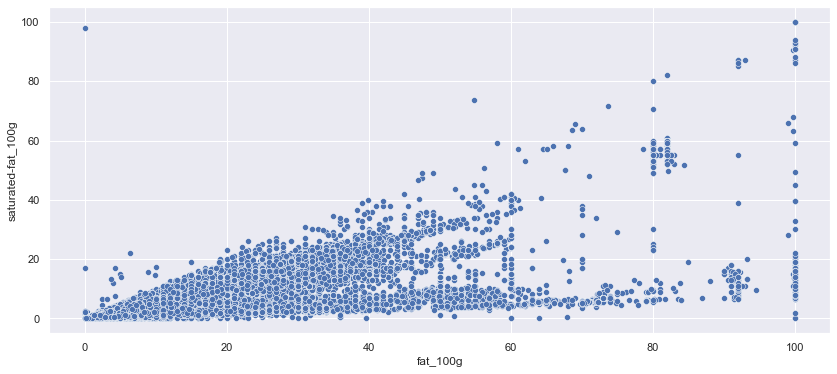

In [669]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'fat_100g',y= 'saturated-fat_100g')

<AxesSubplot:xlabel='fat_100g', ylabel='energy_kj'>

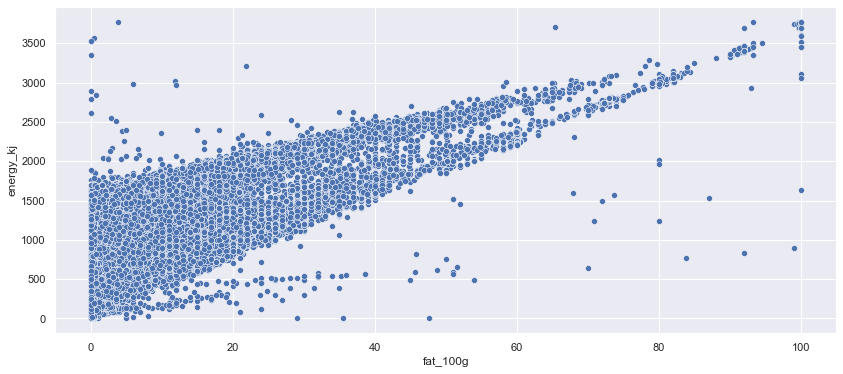

In [670]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'fat_100g',y= 'energy_kj')

<AxesSubplot:>

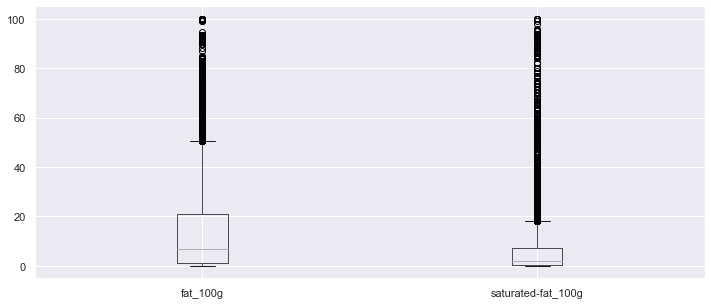

In [671]:
plt.figure(figsize=(12,5))
df_new[[ 'fat_100g','saturated-fat_100g']].boxplot(figsize=(16,10))

In [672]:
# Transformer les valeurs supérieures à 54 en NaN dans la colonne
df_new.loc[df_new['saturated-fat_100g'] > df_new["fat_100g"],['saturated-fat_100g'] = np.nan
           #utilser la methode pour le sucre

In [673]:
df_new['saturated-fat_100g'].max()

54.0

<AxesSubplot:xlabel='fat_100g', ylabel='saturated-fat_100g'>

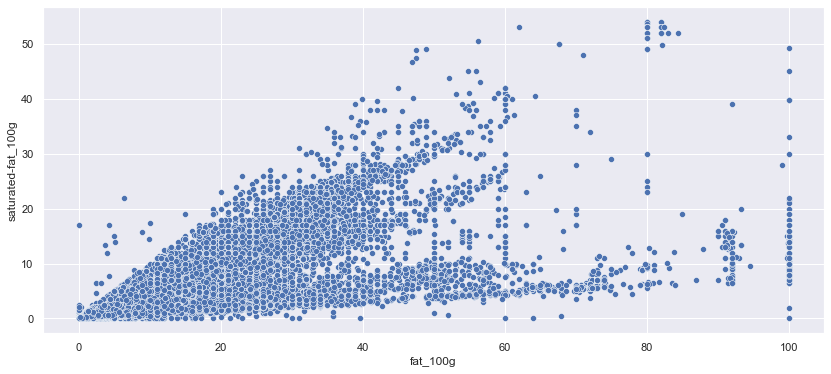

In [674]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'fat_100g',y= 'saturated-fat_100g')

In [675]:
df_new.shape

(63563, 24)

### Utiliser iterative imputer 

In [676]:
# créer une instance de IterativeImputer
imputer = IterativeImputer()

In [677]:
imputed_data_fat = imputer.fit_transform(df_new[['fat_100g','saturated-fat_100g','energy_kj']])

In [678]:
df_new[['fat_100g','saturated-fat_100g','energy_kj']]= imputed_data_fat

### Verifier les résultats

In [679]:

df_new[['fat_100g','saturated-fat_100g','energy_kj']].isnull().sum()

fat_100g              0
saturated-fat_100g    0
energy_kj             0
dtype: int64

<AxesSubplot:xlabel='fat_100g', ylabel='saturated-fat_100g'>

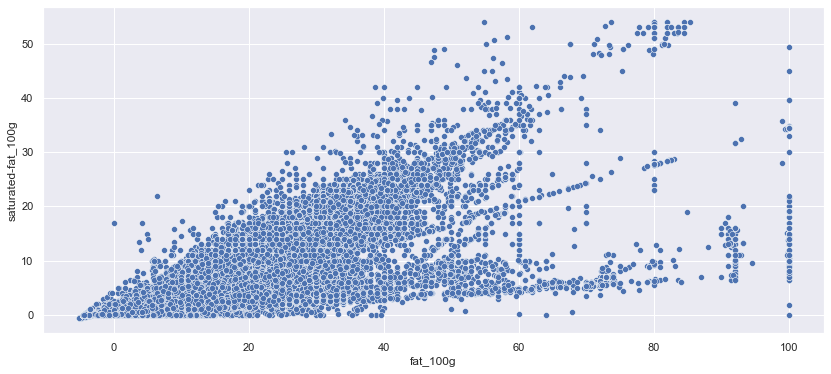

In [680]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'fat_100g',y= 'saturated-fat_100g')

<AxesSubplot:xlabel='fat_100g', ylabel='energy_kj'>

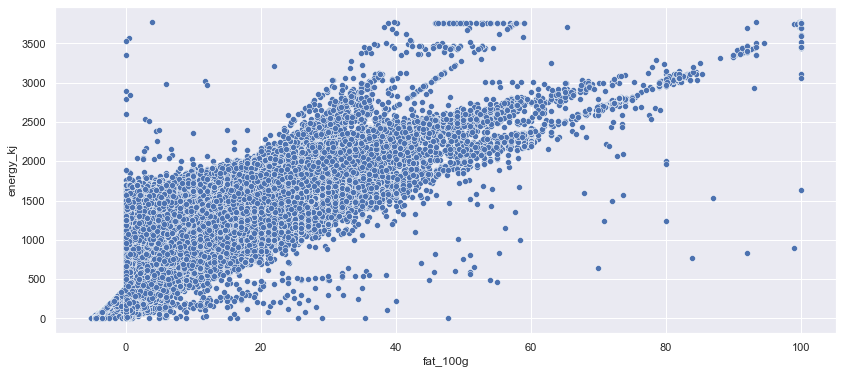

In [681]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'fat_100g',y= 'energy_kj')

### colonne additive n

In [682]:
df_new["additives_n"].value_counts()

0.0     16504
1.0      7862
2.0      5543
3.0      4130
4.0      2783
5.0      2085
6.0      1371
7.0       956
8.0       662
9.0       433
10.0      269
11.0      195
12.0      139
13.0       92
14.0       89
15.0       55
16.0       31
17.0       13
18.0        9
20.0        4
21.0        3
31.0        3
19.0        3
Name: additives_n, dtype: int64

In [683]:
df_new["additives_n"].corr(df_new["count_ingredient"])

0.605673313437385

<AxesSubplot:xlabel='additives_n', ylabel='count_ingredient'>

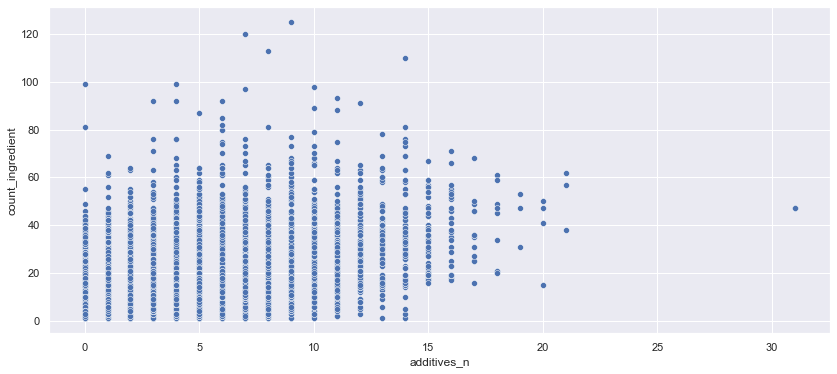

In [684]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'additives_n',y= 'count_ingredient')

<AxesSubplot:xlabel='count_ingredient', ylabel='additives_n'>

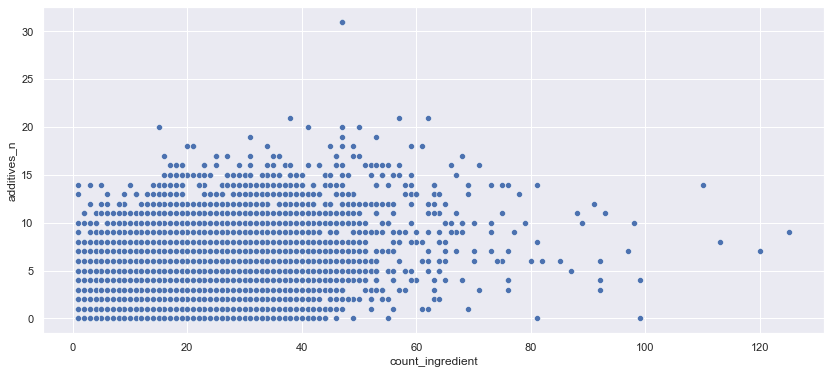

In [685]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'count_ingredient',y= 'additives_n')

In [686]:
df_new['count_ingredient'].isnull().sum()

0

In [687]:
# créer une instance de IterativeImputer
imputer = IterativeImputer()

In [688]:
imputed_data_additive = imputer.fit_transform(df_new[['count_ingredient','additives_n']])

In [689]:
df_new[['count_ingredient','additives_n']] =imputed_data_additive  

### observer les résultats

In [690]:

df_new[['count_ingredient','additives_n']].isnull().sum()

count_ingredient    0
additives_n         0
dtype: int64

<AxesSubplot:xlabel='count_ingredient', ylabel='additives_n'>

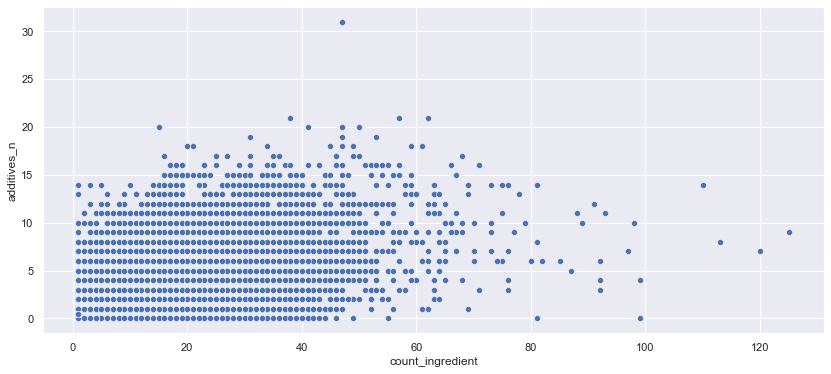

In [691]:
plt.figure(figsize=(14,6))
sns.scatterplot(data = df_new, x = 'count_ingredient',y= 'additives_n')

### colonne ingredients_from_palm_oil_n

<AxesSubplot:title={'center':'pal oil column'}>

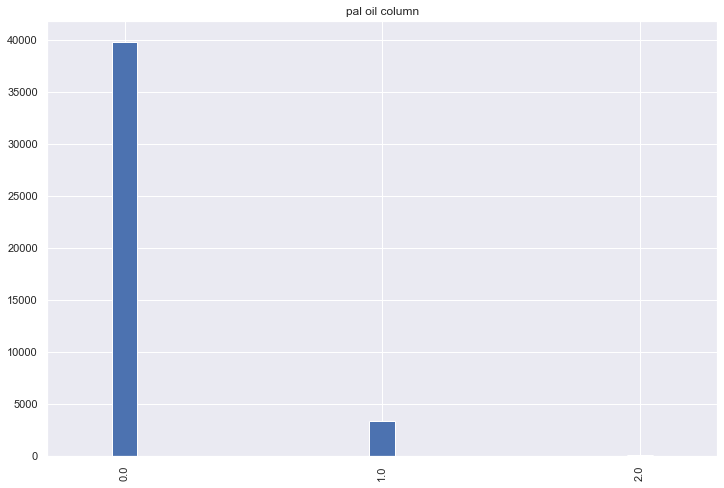

In [692]:
plt.figure(figsize=(12,8))
plt.title("pal oil column")
df_new["ingredients_from_palm_oil_n"].value_counts().plot(kind= 'bar', width = 0.1)


In [693]:
df_new["ingredients_from_palm_oil_n"].isnull().mean()

0.3198244261598729

In [694]:
df_new["ingredients_from_palm_oil_n"].value_counts()

0.0    39845
1.0     3342
2.0       47
Name: ingredients_from_palm_oil_n, dtype: int64

### remplacer les valeurs manquantes par la valeur la plus fréquente

In [695]:
# Calculer la valeur la plus présente de la colonne
most_frequent_value = df_new["ingredients_from_palm_oil_n"].mode()[0]

most_frequent_value

0.0

In [696]:
# creer le simple iputer avec la valeur la plus frequente
imputer = SimpleImputer(strategy='most_frequent')



In [697]:
# selectionner la colonne
column_to_impute = "ingredients_from_palm_oil_n"

# impute les valeurs manquantes
imputed_column = imputer.fit_transform(df_new[[column_to_impute]])


In [698]:
# remplace l'original 
df_new[column_to_impute] = imputed_column

<AxesSubplot:title={'center':'ingredient with palm oil'}>

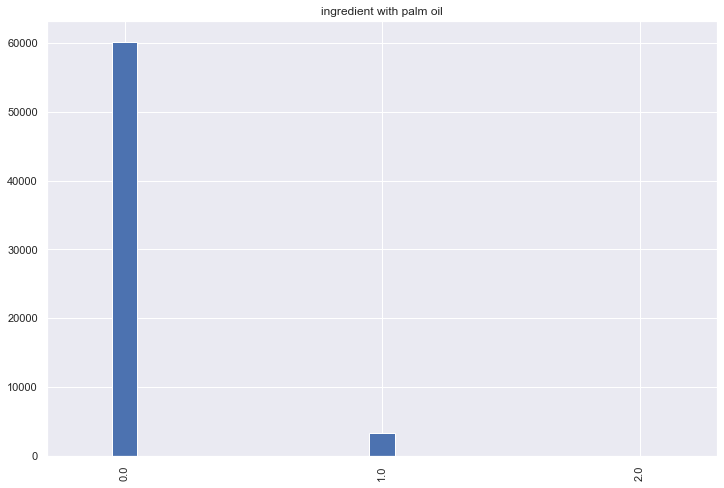

In [700]:
plt.figure(figsize=(12,8))
plt.title("ingredient with palm oil")
df_new["ingredients_from_palm_oil_n"].value_counts().plot(kind= 'bar', width = 0.1)

### utiliser la fonction rate_completude pour regarder les valeurs nulles

In [701]:
rate_completion(df_new)

,completion_rate,number_of_missing_data
code,100.00,0
states,100.00,0
salt_100g,100.00,0
sugars_100g,100.00,0
carbohydrates_100g,100.00,0
saturated-fat_100g,100.00,0
fat_100g,100.00,0
energy_kj,100.00,0
created_datetime,100.00,1
states_fr,100.00,0


## observer les colonnes qui reste

<AxesSubplot:>

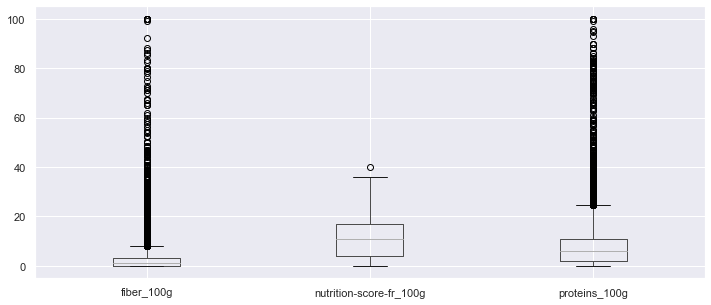

In [702]:
plt.figure(figsize=(12,5))
df_new[['fiber_100g','nutrition-score-fr_100g','proteins_100g']].boxplot(figsize=(16,10))

## colonne fibre et protein

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='fiber_100g', ylabel='Density'>

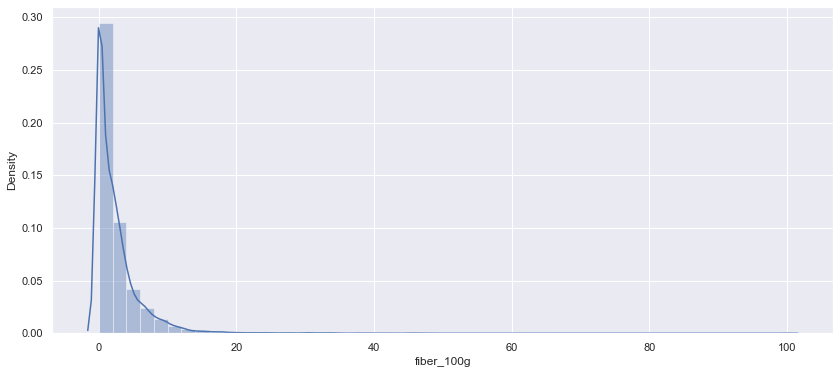

In [705]:
plt.figure(figsize=(14,6))
sns.distplot(df_new['fiber_100g'])

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='proteins_100g', ylabel='Density'>

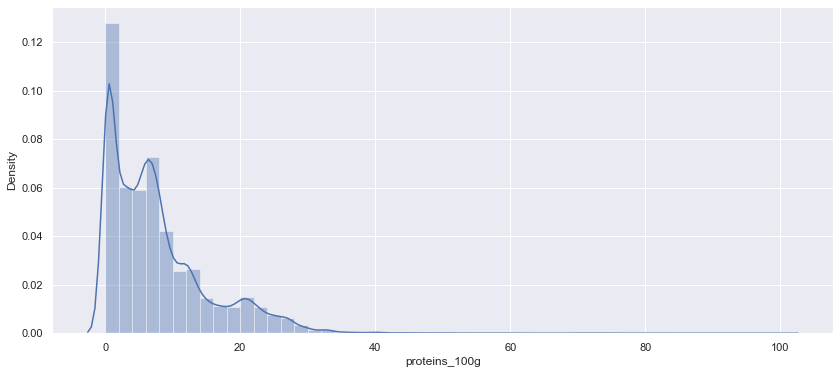

In [706]:
plt.figure(figsize=(14,6))
sns.distplot(df_new['proteins_100g'])

In [707]:
median_fibre = df_new['fiber_100g'].median()

In [708]:
median_protein = df_new['proteins_100g'].median()

In [709]:
df_new['fiber_100g'].fillna(median_fibre, inplace = True)

In [710]:
df_new['proteins_100g'].fillna(median_protein, inplace = True)

In [711]:
df_new[['proteins_100g','fiber_100g']].isnull().sum()

proteins_100g    0
fiber_100g       0
dtype: int64

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='proteins_100g', ylabel='Density'>

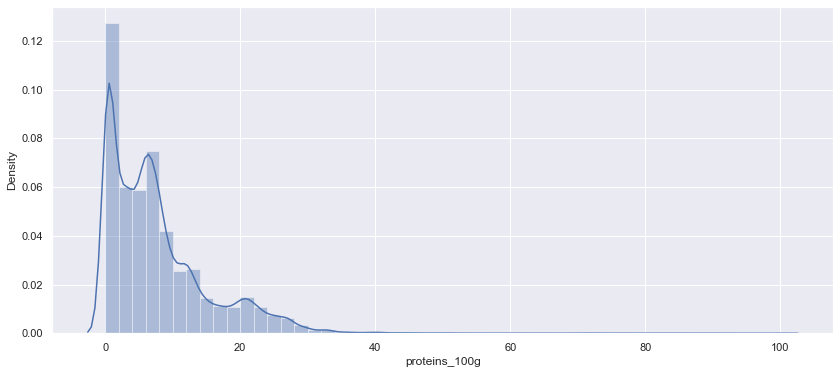

In [712]:
plt.figure(figsize=(14,6))
sns.distplot(df_new['proteins_100g'])


C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='fiber_100g', ylabel='Density'>

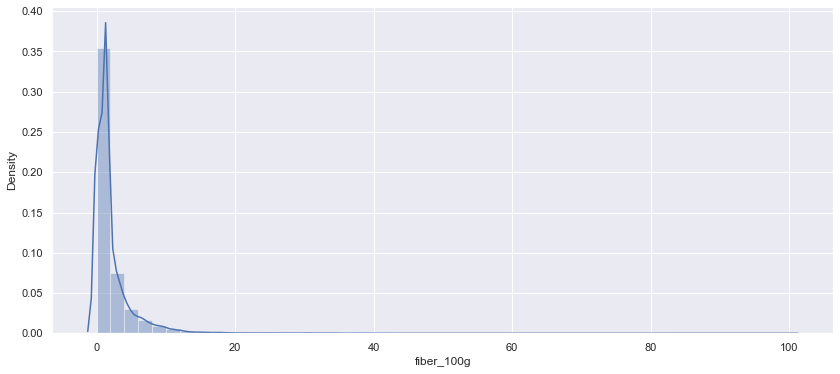

In [713]:
plt.figure(figsize=(14,6))
sns.distplot(df_new['fiber_100g'])

### Colonne nutriscore grade et nutriscore grade 100g

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='nutrition-score-fr_100g', ylabel='Density'>

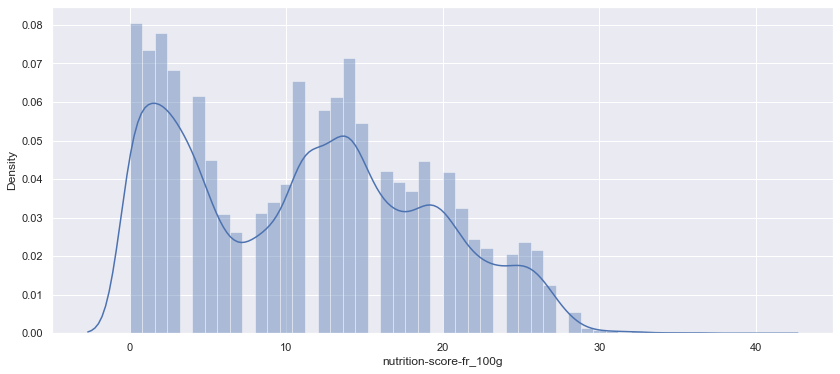

In [715]:
plt.figure(figsize=(14,6))
sns.distplot(df_new['nutrition-score-fr_100g'])

In [463]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 63563 entries, 106 to 320763
Data columns (total 24 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   code                         63563 non-null  object 
 1   created_datetime             63562 non-null  object 
 2   last_modified_t              63563 non-null  object 
 3   last_modified_datetime       63563 non-null  object 
 4   product_name                 63563 non-null  object 
 5   brands                       63313 non-null  object 
 6   categories_fr                46852 non-null  object 
 7   additives_n                  63563 non-null  float64
 8   ingredients_from_palm_oil_n  63563 non-null  float64
 9   nutrition_grade_fr           60398 non-null  object 
 10  states                       63563 non-null  object 
 11  states_fr                    63563 non-null  object 
 12  main_category                46852 non-null  object 
 13  main_category

### utiliser simple imputer et remplacer par la plus frequentes

In [716]:
# creer le simple iputer avec la valeur la plus frequente
imputer = SimpleImputer(strategy='most_frequent')

In [717]:
# Appliquer la méthode fit_transform() sur la colonne contenant les valeurs manquantes
df_new['nutrition-score-fr_100g'] = imputer.fit_transform(df_new[['nutrition-score-fr_100g']])


### observer les resultats 

C:\Users\naoue\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='nutrition-score-fr_100g', ylabel='Density'>

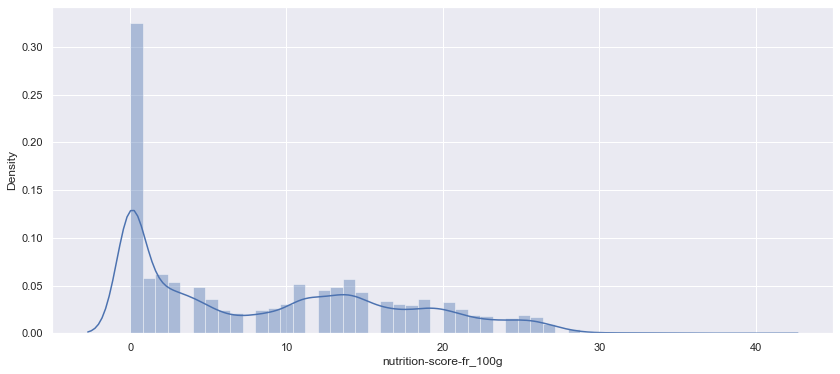

In [718]:
plt.figure(figsize=(14,6))
sns.distplot(df_new['nutrition-score-fr_100g'])

<AxesSubplot:>

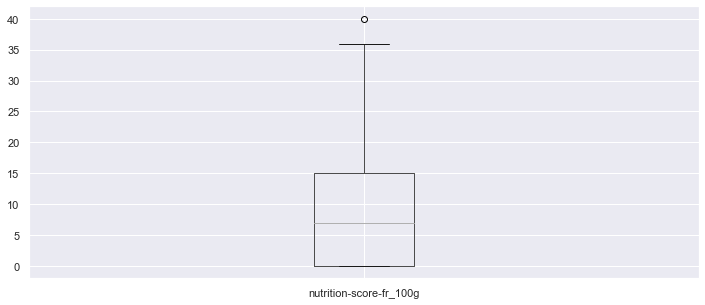

In [719]:
plt.figure(figsize=(12,5))
df_new[['nutrition-score-fr_100g']].boxplot(figsize=(16,10))

<AxesSubplot:xlabel='nutrition_grade_fr', ylabel='count'>

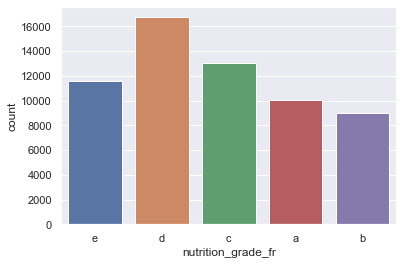

In [714]:
sns.countplot(x = 'nutrition_grade_fr', data = df_new)

In [720]:
# creer le simple iputer avec la valeur la plus frequente
imputer = SimpleImputer(strategy='most_frequent')

In [722]:
# Appliquer la méthode fit_transform() sur la colonne contenant les valeurs manquantes
df_new['nutrition_grade_fr'] = imputer.fit_transform(df_new[['nutrition_grade_fr']])


### observer les résultats

<AxesSubplot:xlabel='nutrition_grade_fr', ylabel='count'>

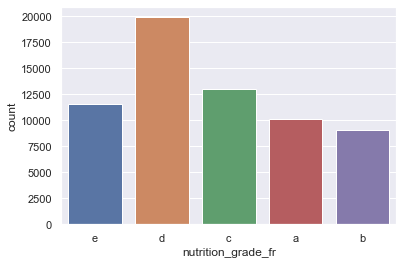

In [723]:
sns.countplot(x = 'nutrition_grade_fr', data = df_new)

### Create an organic column

In [ ]:
data_less_outliers["product_name"].value_counts()

In [ ]:
data_less_outliers["organic_product"] = (data_less_outliers["product_name"].str.find("Organic"))## find word organic

In [ ]:
data_less_outliers.head()

In [ ]:
condi = [(data_less_outliers['organic_product'] >= 0), (data_less_outliers['organic_product'] < 0)]

In [ ]:
value = ['organic', 'not_organic']

In [ ]:
data_less_outliers['organic_or_not'] = np.select(condi, value)

In [ ]:
data_less_outliers['organic_or_not'].value_counts()

In [ ]:
corr = data.corr()

In [ ]:
corr

In [ ]:
pearson_correlations = data_corr.select_dtypes(include='float64').corr() * 100
cleanning_mask = np.zeros_like(pearson_correlations)
upper_triangle = np.triu_indices_from(pearson_correlations)
cleanning_mask[upper_triangle] = 1

plt.figure(figsize=(9,8))

sns.heatmap(pearson_correlations, cmap="RdBu_r", mask = cleanning_mask, 
           annot = True, fmt=".0f", cbar=False)
plt.title("Matrice de corrélations linéaires en %")
plt.show()